In [1]:
# Libraries
import numpy as np
import pandas as pd
from pandas.api.types import is_numeric_dtype
import matplotlib.pyplot as plt
import seaborn as sns
import gc
from sklearn.linear_model import BayesianRidge, LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
import pprint
from patsy import dmatrices
from yellowbrick.regressor import ResidualsPlot, PredictionError
from scipy import stats


sns.set()

In [2]:
# Train data
train = pd.read_csv("data_files/train.csv", header = 0)
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20216100 entries, 0 to 20216099
Data columns (total 4 columns):
building_id      int64
meter            int64
timestamp        object
meter_reading    float64
dtypes: float64(1), int64(2), object(1)
memory usage: 616.9+ MB


In [3]:
# Building meta data
building = pd.read_csv("data_files/building_metadata.csv")
building.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1449 entries, 0 to 1448
Data columns (total 6 columns):
site_id        1449 non-null int64
building_id    1449 non-null int64
primary_use    1449 non-null object
square_feet    1449 non-null int64
year_built     675 non-null float64
floor_count    355 non-null float64
dtypes: float64(2), int64(3), object(1)
memory usage: 68.0+ KB


In [4]:
# Weather train data
weather_train = pd.read_csv("data_files/weather_train.csv")
weather_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 139773 entries, 0 to 139772
Data columns (total 9 columns):
site_id               139773 non-null int64
timestamp             139773 non-null object
air_temperature       139718 non-null float64
cloud_coverage        70600 non-null float64
dew_temperature       139660 non-null float64
precip_depth_1_hr     89484 non-null float64
sea_level_pressure    129155 non-null float64
wind_direction        133505 non-null float64
wind_speed            139469 non-null float64
dtypes: float64(7), int64(1), object(1)
memory usage: 9.6+ MB


In [5]:
del train, building, weather_train
_ = gc.collect()

In [2]:
def memory_reduction(df):
    itypes = [np.int8, np. int16, np.int32, np.int64] 
    ftypes = [np.float32, np.float64]
    iinfo = [np.iinfo(t) for t in itypes]
    finfo = [np.finfo(t) for t in ftypes]
    for col in df:
        if is_numeric_dtype(df[col]):
            col_max = df[col].max()
            col_min = df[col].min()
            if np.issubdtype(df[col].dtype, np.integer):
                for ii in iinfo:
                    if col_min >= ii.min and col_max <= ii.max:
                        df[col] = df[col].astype(ii.dtype)
                        break
            else:
                for fi in finfo:
                    if col_min >= fi.min and col_max <= fi.max:
                        df[col] = df[col].astype(fi.dtype)
                        break
    return df

In [3]:
def load_data(base, task):
    data = memory_reduction(pd.read_csv(f"{base}/{task}.csv", parse_dates = ['timestamp']))
    building = memory_reduction(pd.read_csv(f"{base}/building_metadata.csv"))
    weather = memory_reduction(pd.read_csv(f"{base}/weather_{task}.csv", parse_dates = ['timestamp']))
    return data.merge(building.merge(weather, on = "site_id", how = "left"), how = "left", on = ["building_id", "timestamp"])

In [4]:
train = load_data("data_files", "train")
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20216100 entries, 0 to 20216099
Data columns (total 16 columns):
building_id           int16
meter                 int8
timestamp             datetime64[ns]
meter_reading         float32
site_id               float64
primary_use           object
square_feet           float64
year_built            float32
floor_count           float32
air_temperature       float32
cloud_coverage        float32
dew_temperature       float32
precip_depth_1_hr     float32
sea_level_pressure    float32
wind_direction        float32
wind_speed            float32
dtypes: datetime64[ns](1), float32(10), float64(2), int16(1), int8(1), object(1)
memory usage: 1.6+ GB


In [9]:
test = load_data("data_files", "test")
test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 41697600 entries, 0 to 41697599
Data columns (total 16 columns):
row_id                int32
building_id           int16
meter                 int8
timestamp             datetime64[ns]
site_id               float64
primary_use           object
square_feet           float64
year_built            float16
floor_count           float16
air_temperature       float16
cloud_coverage        float16
dew_temperature       float16
precip_depth_1_hr     float16
sea_level_pressure    float16
wind_direction        float16
wind_speed            float16
dtypes: datetime64[ns](1), float16(9), float64(2), int16(1), int32(1), int8(1), object(1)
memory usage: 2.5+ GB


In [10]:
# Meter types as on the competition page
meter_type = {0: "electricity", 1: "chilledwater", 2: "steam", 3: "hotwater"}

## EDA

### Null Values

<Figure size 432x288 with 0 Axes>

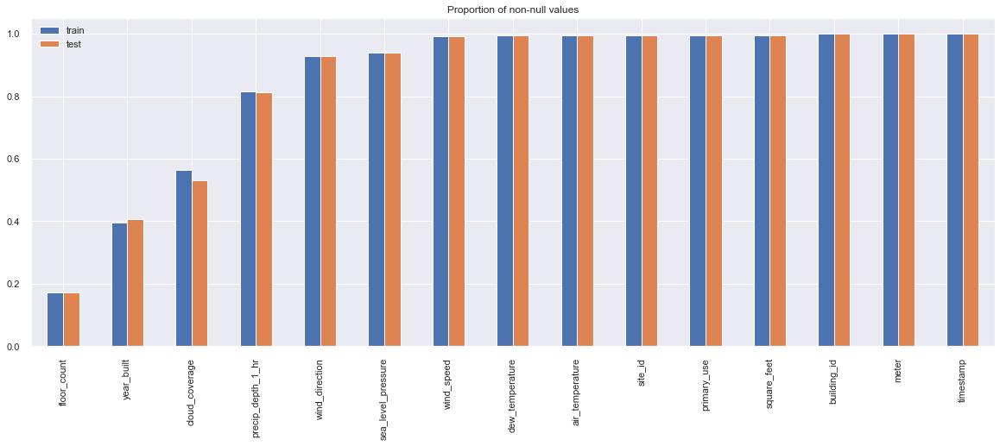

In [11]:
plt.clf()
(train.count()/len(train)).sort_values().to_frame("train").merge((test.count()/len(test)).to_frame("test"), left_index = True, right_index = True).plot.bar(title = "Proportion of non-null values", figsize = (20, 7))

### Target Variable - Meter Reading

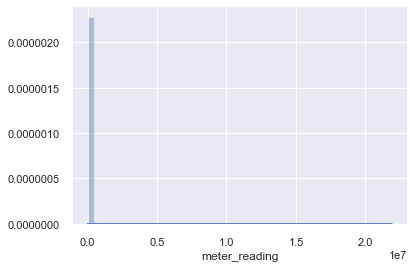

In [12]:
plt.clf()
sns.distplot(train["meter_reading"])

We can't properly visualize "meter_reading" due to some very large values which could be outliers. Let's take a log transformation and visualize the meter reading grouped by meter type.

<Figure size 432x288 with 0 Axes>

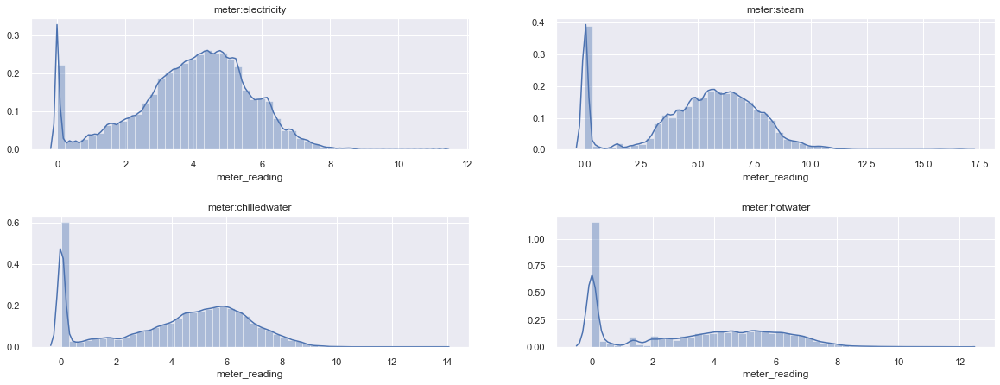

In [13]:
plt.clf()
grouped = train[["meter", "meter_reading"]].groupby("meter")
fig, ax = plt.subplots(2, 2, figsize = (20, 7))
plt.subplots_adjust(hspace = 0.5)
i = 0
for name, group in grouped:
    _ = sns.distplot(np.log1p(group['meter_reading']), ax = ax[i%2, i//2], label = name)
    ax[i%2, i//2].set_title("meter:" + str(meter_type[name])) 
    i+=1

In [14]:
# Summary of meter readings
train['meter_reading'].describe()

count    2.021610e+07
mean     1.988706e+03
std      1.532159e+05
min      0.000000e+00
25%      1.830000e+01
50%      7.877500e+01
75%      2.679840e+02
max      2.190470e+07
Name: meter_reading, dtype: float64

There seems to be a lot of rows with 0 meter readings. Let's see the proportion of data with 0 meter reading..

In [15]:
# Percentage of traininig data with 0 meter_reading
round(train.loc[train.meter_reading == 0, 'meter_reading'].count()*100/len(train), 2)

9.27

Checking the distribution of mean meter reading over time..
Inspired By [EDA for ASHRAE](https://www.kaggle.com/nroman/eda-for-ashrae)

<Figure size 432x288 with 0 Axes>

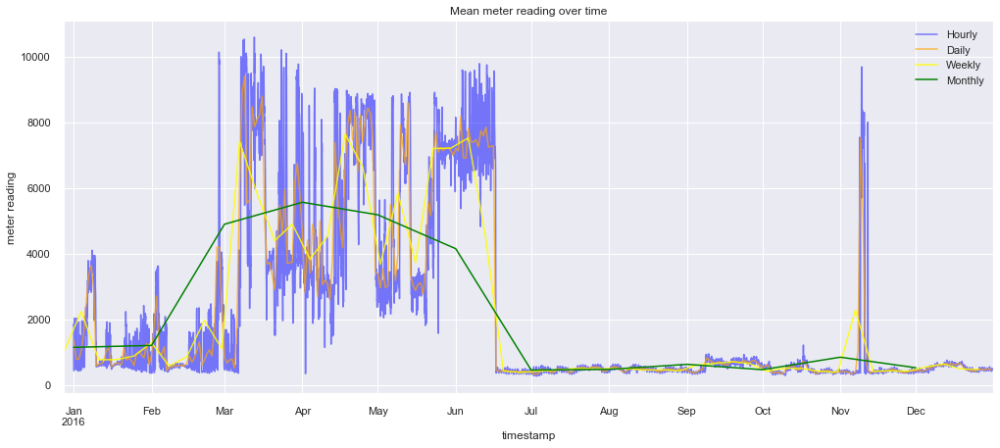

In [16]:
# Mean meter reading over time
plt.clf()
fig, ax = plt.subplots(figsize = (17, 7))
train[["timestamp", "meter_reading"]].set_index("timestamp").resample("H").mean()["meter_reading"].plot(ax = ax, label = "Hourly", color = "blue", alpha = 0.5)
train[["timestamp", "meter_reading"]].set_index("timestamp").resample("D").mean()["meter_reading"].plot(ax = ax, label = "Daily", color = "orange", alpha = 0.7)
train[["timestamp", "meter_reading"]].set_index("timestamp").resample("W").mean()["meter_reading"].plot(ax = ax, label = "Weekly", color = "yellow", alpha = 0.85)
train[["timestamp", "meter_reading"]].set_index("timestamp").resample("M").mean()["meter_reading"].plot(ax = ax, label = "Monthly", color = "green", alpha = 1)
ax.set_title("Mean meter reading over time")
ax.set_ylabel("meter reading")
ax.legend(loc = "best")

The graph has weird surges from the months of May to June and then again around Novemeber. Let's facet the graph using site_id to see if a particular region is responsible for this anomaly.

In [17]:
plt.clf()
grouped = train[["site_id", "timestamp", "meter_reading"]].groupby("site_id")
i = 0
fig, ax = plt.subplots(8, 2, figsize = (20, 50), dpi = 400)
for name, group in grouped:
    group.set_index("timestamp").resample("H").mean()["meter_reading"].plot(ax = ax[i%8,i//8], label = "Hourly", color = "blue", alpha = 0.5)
    group.set_index("timestamp").resample("D").mean()["meter_reading"].plot(ax = ax[i%8,i//8], label = "Daily", color = "orange", alpha = 0.7)
    group.set_index("timestamp").resample("W").mean()["meter_reading"].plot(ax = ax[i%8,i//8], label = "Weekly", color = "yellow", alpha = 0.85)
    group.set_index("timestamp").resample("M").mean()["meter_reading"].plot(ax = ax[i%8,i//8], label = "Monthly", color = "green", alpha = 1)
    ax[i%8,i//8].set_title("site_id: " + str(name))
    ax[i%8,i//8].set_ylabel("meter reading")
    ax[i%8,i//8].legend()
    i+=1

<Figure size 432x288 with 0 Axes>

Of the above graphs, site_id = 13.0 is exactly similar to the graph we got for overall data implying it's heavily skewing the mean meter reading. Let's dig deeper and study the average meter reading of buildings in site 13.0 grouped by their primary_usage key..

In [18]:
plt.clf()
grouped = train.loc[train["site_id"] == 13.0, ["primary_use", "timestamp", "meter_reading"]].groupby("primary_use")
i = 0
fig, ax = plt.subplots(7, 2, figsize = (20, 50), dpi = 400)
for name, group in grouped:
    group.set_index("timestamp").resample("H").mean()["meter_reading"].plot(ax = ax[i%7,i//7], label = "Hourly", color = "blue", alpha = 0.5)
    group.set_index("timestamp").resample("D").mean()["meter_reading"].plot(ax = ax[i%7,i//7], label = "Daily", color = "orange", alpha = 0.7)
    group.set_index("timestamp").resample("W").mean()["meter_reading"].plot(ax = ax[i%7,i//7], label = "Weekly", color = "yellow", alpha = 0.85)
    group.set_index("timestamp").resample("M").mean()["meter_reading"].plot(ax = ax[i%7,i//7], label = "Monthly", color = "green", alpha = 1)
    ax[i%7,i//7].set_title("primary_use: " + str(name))
    ax[i%7,i//7].set_ylabel("meter reading")
    ax[i%7,i//7].legend()
    i+=1

<Figure size 432x288 with 0 Axes>

The average meter reading for educational buildings seems to be the culprit here. Let's dig deeper and find out if it's just one building that's causing these anomalies..

In [19]:
plt.clf()
grouped = train.loc[(train["site_id"] == 13.0) & (train["primary_use"] == "Education"), ["building_id", "timestamp", "meter_reading"]].groupby("building_id")
i = 0
fig, ax = plt.subplots(13, 2, figsize = (20, 50), dpi = 400)
for name, group in grouped:
    group.set_index("timestamp").resample("H").mean()["meter_reading"].plot(ax = ax[i%13,i//13], label = "Hourly", color = "blue", alpha = 0.5)
    group.set_index("timestamp").resample("D").mean()["meter_reading"].plot(ax = ax[i%13,i//13], label = "Daily", color = "orange", alpha = 0.7)
    group.set_index("timestamp").resample("W").mean()["meter_reading"].plot(ax = ax[i%13,i//13], label = "Weekly", color = "yellow", alpha = 0.85)
    group.set_index("timestamp").resample("M").mean()["meter_reading"].plot(ax = ax[i%13,i//13], label = "Monthly", color = "green", alpha = 1)
    ax[i%13,i//13].set_title("building_id" + str(name))
    ax[i%13,i//13].set_ylabel("meter reading")
    ax[i%13,i//13].legend()
    i+=1

<Figure size 432x288 with 0 Axes>

The building building_id = "1099", site_id = "13.0" and primary_use = "Education" has very average meter reading which is not seen for other buildings. Let's look at 

In [20]:
train[(train["site_id"] == 13.0) & (train["primary_use"] == "Education") & (train["building_id"] == 1099)].describe()

D:\Anaconda3\lib\site-packages\pandas\core\nanops.py:120: RuntimeWarning: Mean of empty slice
  result = bn_func(values, axis=axis, **kwds)
D:\Anaconda3\lib\site-packages\pandas\core\nanops.py:120: RuntimeWarning: Mean of empty slice
  result = bn_func(values, axis=axis, **kwds)


,building_id,meter,meter_reading,site_id,square_feet,year_built,floor_count,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr,sea_level_pressure,wind_direction,wind_speed
count,17564.0,17564.000000,1.756400e+04,17564.0,17564.0,0.0,0.0,1.756200e+04,8968.000000,1.756200e+04,17540.000000,1.732400e+04,17130.0000,1.756200e+04
mean,1099.0,1.000114,1.907542e+06,13.0,332884.0,NaN,NaN,inf,2.875000,inf,0.880859,inf,inf,inf
std,0.0,1.000028,4.834940e+06,0.0,0.0,NaN,NaN,1.240625e+01,2.712891,1.138281e+01,7.804688,7.664062e+00,105.0625,2.324219e+00
min,1099.0,0.000000,1.440000e+02,13.0,332884.0,NaN,NaN,-2.890625e+01,0.000000,-3.170312e+01,-1.000000,9.815000e+02,0.0000,0.000000e+00
25%,1099.0,0.000000,5.203910e+02,13.0,332884.0,NaN,NaN,6.000977e-01,0.000000,-3.900391e+00,0.000000,1.011000e+03,120.0000,2.599609e+00
50%,1099.0,2.000000,9.856970e+02,13.0,332884.0,NaN,NaN,1.110156e+01,2.000000,3.900391e+00,0.000000,1.016000e+03,180.0000,4.101562e+00
75%,1099.0,2.000000,7.008000e+03,13.0,332884.0,NaN,NaN,2.000000e+01,4.000000,1.329688e+01,0.000000,1.021000e+03,280.0000,5.699219e+00
max,1099.0,2.000000,2.190470e+07,13.0,332884.0,NaN,NaN,3.559375e+01,9.000000,2.500000e+01,216.000000,1.040000e+03,360.0000,1.600000e+01


<Figure size 432x288 with 0 Axes>

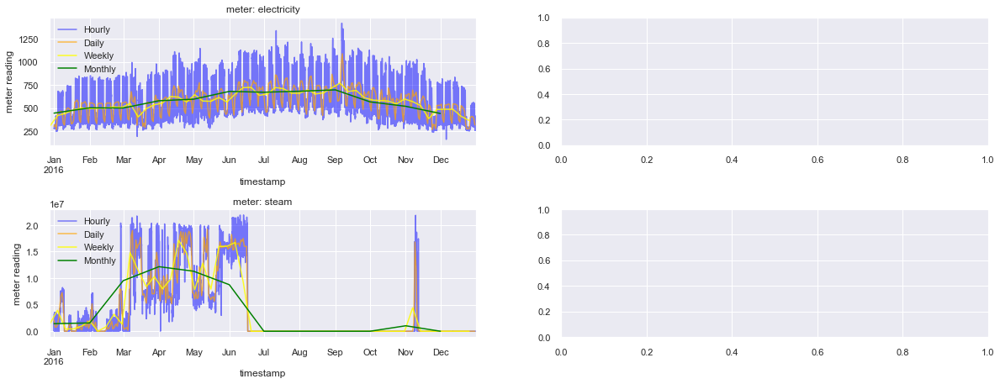

In [21]:
plt.clf()
grouped = train.loc[(train["site_id"] == 13.0) & (train["primary_use"] == "Education") & (train["building_id"] == 1099), ["timestamp", "meter", "meter_reading"]].groupby("meter")
fig, ax = plt.subplots(2,2, figsize = (20, 7))
plt.subplots_adjust(hspace = 0.5)
i = 0
for name, group in grouped:
    group.set_index("timestamp").resample("H").mean()["meter_reading"].plot(ax = ax[i%2,i//2], label = "Hourly", color = "blue", alpha = 0.5)
    group.set_index("timestamp").resample("D").mean()["meter_reading"].plot(ax = ax[i%2,i//2], label = "Daily", color = "orange", alpha = 0.7)
    group.set_index("timestamp").resample("W").mean()["meter_reading"].plot(ax = ax[i%2,i//2], label = "Weekly", color = "yellow", alpha = 0.85)
    group.set_index("timestamp").resample("M").mean()["meter_reading"].plot(ax = ax[i%2,i//2], label = "Monthly", color = "green", alpha = 1)
    ax[i%2,i//2].set_title("meter: " + str(meter_type[name]))
    ax[i%2,i//2].set_ylabel("meter reading")
    ax[i%2,i//2].legend()
    i+=1

The steam meter reading for building 1099 is off the charts and skewing the target variable.

For site_id = "13.0" and primary_use = "Services", the meter readings were high too. Looking at meter readings in these categories to see if there's an anomaly..

<Figure size 432x288 with 0 Axes>

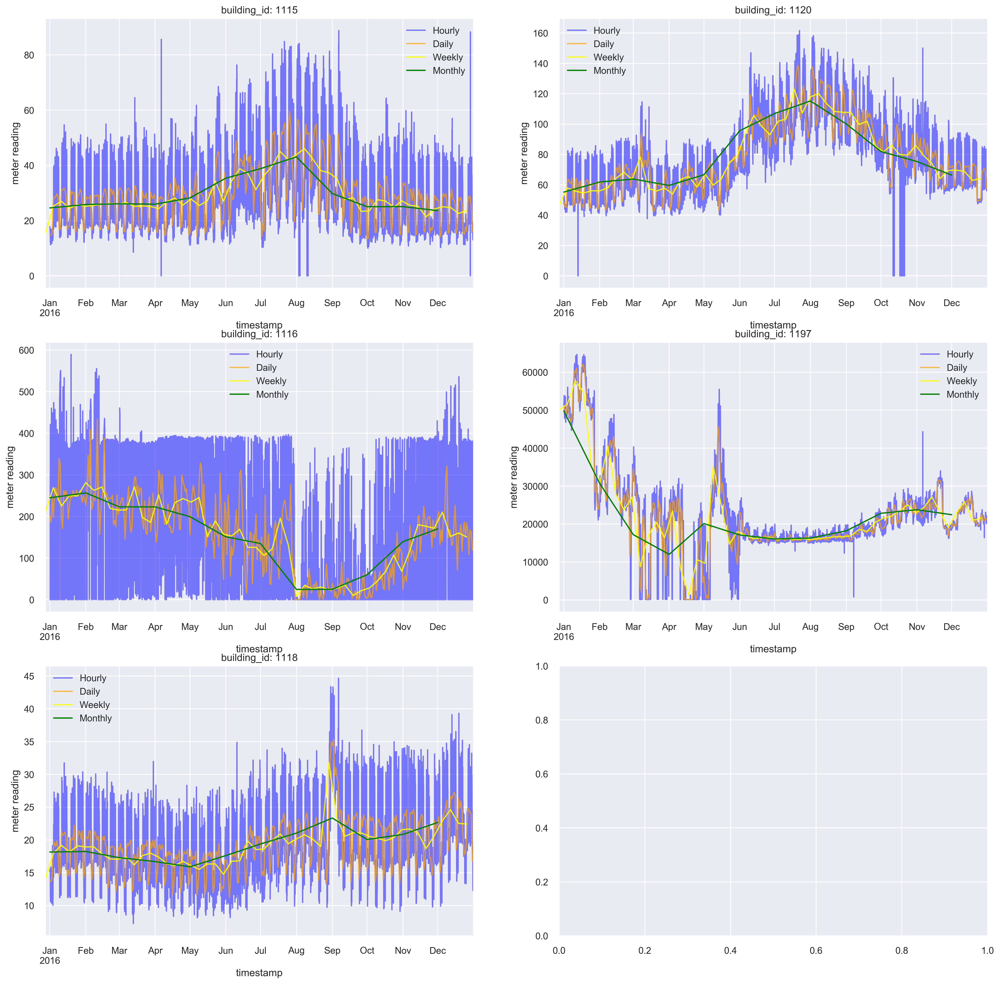

In [22]:
plt.clf()
grouped = train.loc[(train["site_id"] == 13.0) & (train["primary_use"] == "Services"), ["building_id", "timestamp", "meter_reading"]].groupby("building_id")
i = 0
fig, ax = plt.subplots(3, 2, figsize = (20, 20), dpi = 400)
for name, group in grouped:
    group.set_index("timestamp").resample("H").mean()["meter_reading"].plot(ax = ax[i%3,i//3], label = "Hourly", color = "blue", alpha = 0.5)
    group.set_index("timestamp").resample("D").mean()["meter_reading"].plot(ax = ax[i%3,i//3], label = "Daily", color = "orange", alpha = 0.7)
    group.set_index("timestamp").resample("W").mean()["meter_reading"].plot(ax = ax[i%3,i//3], label = "Weekly", color = "yellow", alpha = 0.85)
    group.set_index("timestamp").resample("M").mean()["meter_reading"].plot(ax = ax[i%3,i//3], label = "Monthly", color = "green", alpha = 1)
    ax[i%3,i//3].set_title("building_id: " + str(name))
    ax[i%3,i//3].set_ylabel("meter reading")
    ax[i%3,i//3].legend()
    i+=1

In [23]:
Train = train
Test = test

In [24]:
#Lets check how various meter readings vary throughout the day, week, month and year
Train["timestamp"] = pd.to_datetime(Train["timestamp"])
Train["hour"] = np.uint8(Train["timestamp"].dt.hour)
Train["day"] = np.uint8(Train["timestamp"].dt.day)
# Train["weekday_name"] = Train["timestamp"].dt.weekday_name 
Train["weekday"] = np.uint8(Train["timestamp"].dt.weekday)
Train["month"] = np.uint8(Train["timestamp"].dt.month)

Test["timestamp"] = pd.to_datetime(Test["timestamp"])
Test["hour"] = np.uint8(Test["timestamp"].dt.hour)
Test["day"] = np.uint8(Test["timestamp"].dt.day)
Test["weekday"] = np.uint8(Test["timestamp"].dt.weekday)
Test["month"] = np.uint8(Test["timestamp"].dt.month)

In [25]:
#Throughout the day
meterDay = Train.groupby('hour').meter_reading
meterDay.describe()

,count,mean,std,min,25%,50%,75%,max
hour,,,,,,,,
0,842381.0,2058.181396,150698.593750,0.0,14.890000,64.290001,231.022003,20629700.0
1,840620.0,2025.698730,149067.109375,0.0,14.770000,63.500000,227.000000,20032400.0
2,841829.0,1989.203857,147872.421875,0.0,14.100000,61.615200,221.270996,21112300.0
3,842324.0,1952.469849,145458.281250,0.0,13.800000,60.689999,218.000000,20278300.0
4,842532.0,1955.972778,146170.390625,0.0,13.800000,60.119999,215.732502,20404400.0
5,842240.0,1928.968872,144150.265625,0.0,14.653600,62.825600,223.000000,21508500.0
6,842187.0,1929.777954,141878.093750,0.0,15.993600,68.000000,239.449997,20689300.0
7,842109.0,1979.369995,143677.062500,0.0,17.884300,75.879997,258.007996,21055400.0
8,842237.0,2003.721924,145039.828125,0.0,19.000000,81.967201,270.294006,21874500.0


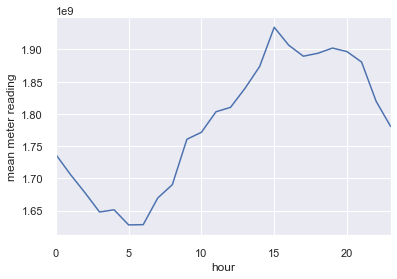

In [26]:
plt.clf()
meterDay.sum().plot()
plt.xlabel("hour")
plt.ylabel("mean meter reading")
plt.show()

The mean meter readings increase from 6AM onwards to peak during 3 pm and decrease thereafter. 
Lets discover the cause of this phenonmenon.

<Figure size 432x288 with 0 Axes>

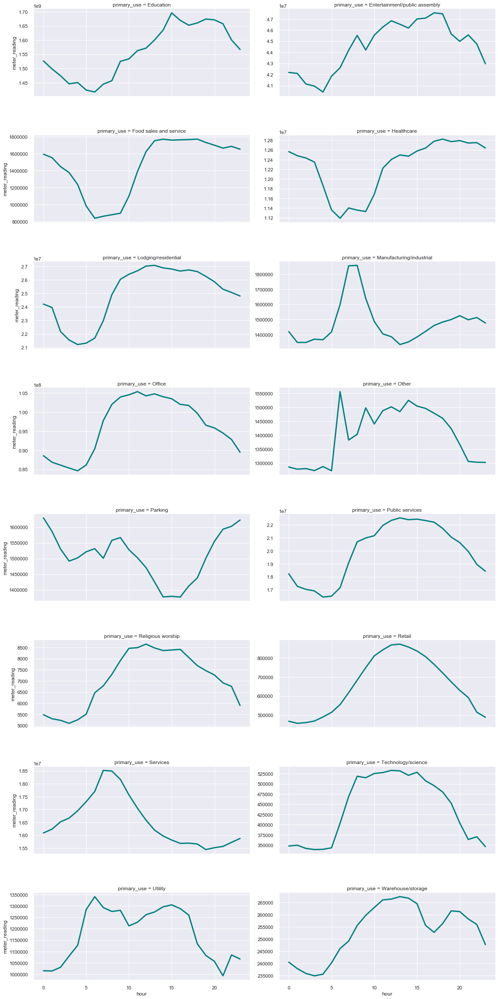

In [27]:
#lets check mean meter reading based on building type throuhout the day
plt.clf()
grouped = Train.groupby(['hour', 'primary_use']).meter_reading.sum().reset_index()
ax = sns.FacetGrid(grouped, col="primary_use", col_wrap=2, height=4, aspect=2,  sharey=False)
ax.map(plt.plot, 'hour', 'meter_reading', color="teal", linewidth = 3)
plt.subplots_adjust(hspace=0.45)
plt.show()

Most buiding types follow a trend similar to the global trend. Thers are however variations which could be specific to the building type. Services, Utility, parking and manufacturing have a significantly different trend than the global trend. 
Lets check whether the trend for manufacuting and services is due to outliers or is it a general trend. 

<Figure size 432x288 with 0 Axes>

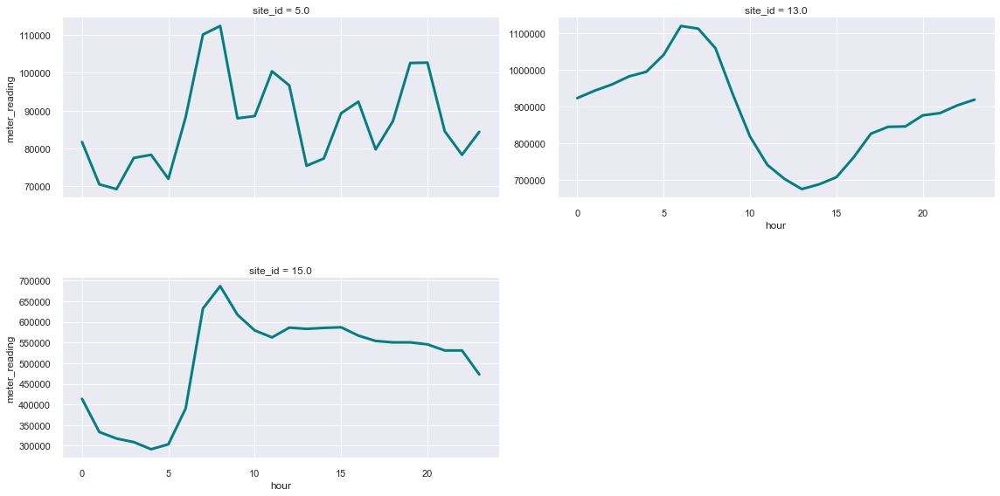

In [28]:
plt.clf()
grouped = Train.loc[(Train["primary_use"]=="Manufacturing/industrial")].groupby(['hour', 'site_id']).meter_reading.sum().reset_index()
ax = sns.FacetGrid(grouped, col="site_id", col_wrap=2, height=4, aspect=2,  sharey=False)
ax.map(plt.plot, 'hour', 'meter_reading', color="teal", linewidth = 3)
plt.subplots_adjust(hspace=0.45)
plt.show()

Site 13 has a distinctly high usage at midnight and low usage during mid-day. Lets see whether this is a general trend at the site or an outlier causing such a trend.

<Figure size 432x288 with 0 Axes>

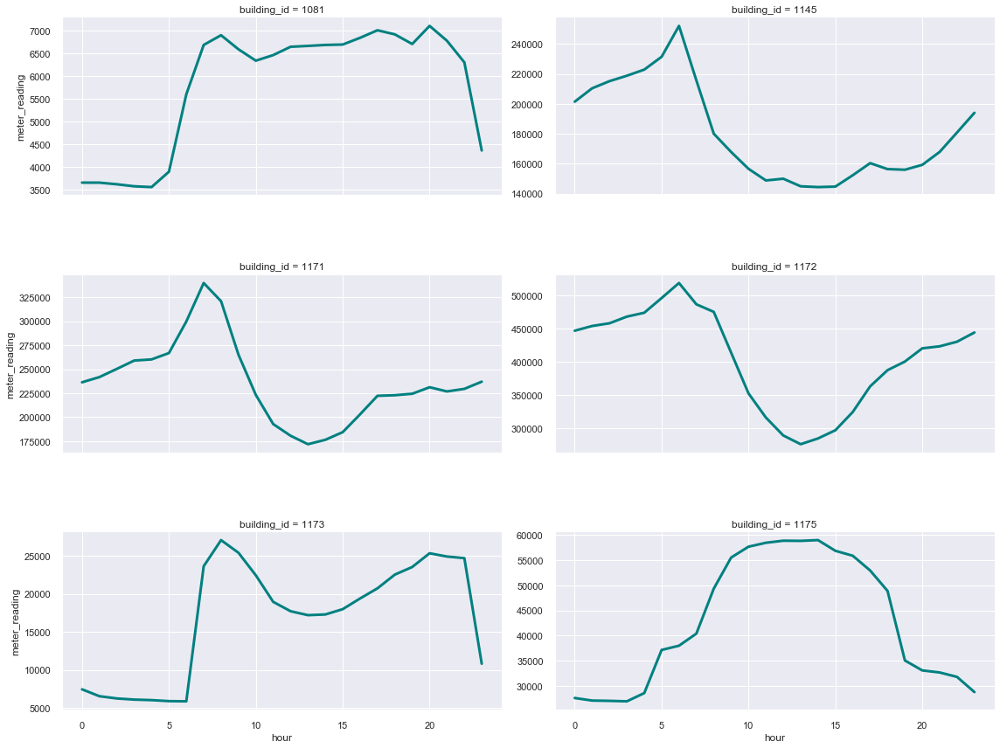

In [29]:
plt.clf()
grouped = Train.loc[(Train["primary_use"]=="Manufacturing/industrial") & (Train["site_id"]==13.0)].groupby(['hour', 'building_id']).meter_reading.sum().reset_index()
ax = sns.FacetGrid(grouped, col="building_id", col_wrap=2, height=4, aspect=2,  sharey=False)
ax.map(plt.plot, 'hour', 'meter_reading', color="teal", linewidth = 3)
plt.subplots_adjust(hspace=0.45)
plt.show()


There are 3 buildings which have a high usage at midnight and low usage during mid_day. Thus this phenomenon cannot be ruled out as being caused by outliers.   Or can it?---- Now lets do a similar analysis for services.

<Figure size 432x288 with 0 Axes>

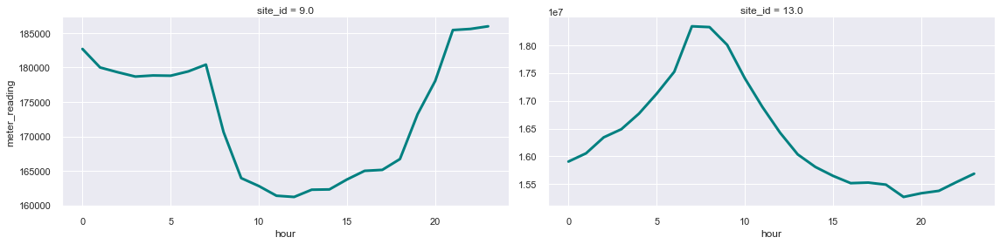

In [30]:
plt.clf()
grouped = Train.loc[(Train["primary_use"]=="Services")].groupby(['hour', 'site_id']).meter_reading.sum().reset_index()
ax = sns.FacetGrid(grouped, col="site_id", col_wrap=2, height=4, aspect=2,  sharey=False)
ax.map(plt.plot, 'hour', 'meter_reading', color="teal", linewidth = 3)
plt.subplots_adjust(hspace=0.45)
plt.show()

Both the trends are dissimilar to the global usage trend but site 13 has a trend almost exaclty the same as the trend for Services in general.

<Figure size 432x288 with 0 Axes>

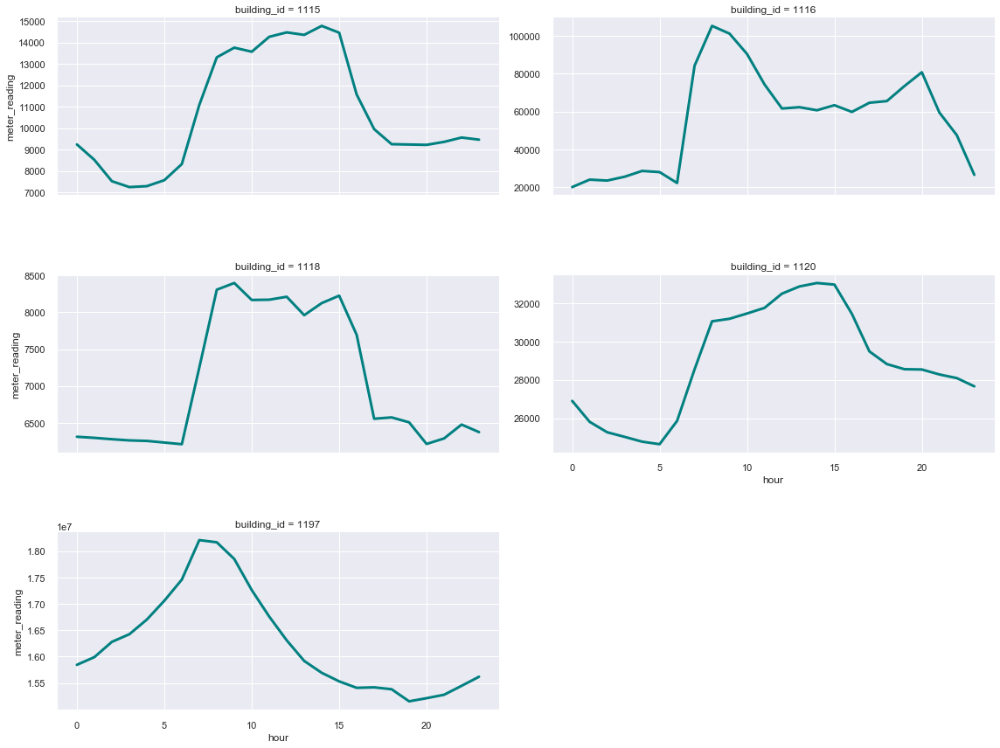

In [31]:
plt.clf()
grouped = Train.loc[(Train["primary_use"]=="Services") & (Train["site_id"]==13.0)].groupby(['hour', 'building_id']).meter_reading.sum().reset_index()
ax = sns.FacetGrid(grouped, col="building_id", col_wrap=2, height=4, aspect=2,  sharey=False)
ax.map(plt.plot, 'hour', 'meter_reading', color="teal", linewidth = 3)
plt.subplots_adjust(hspace=0.45)
plt.show()


It is clear that the trend for services is caused by the building 1197

Lets do similar analysis for weekly usage

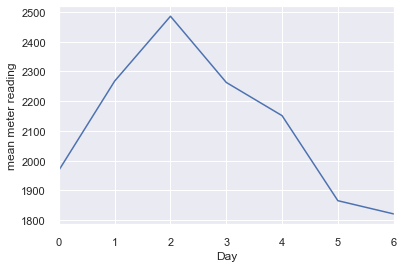

In [32]:
#throughout the week
meterWeek = Train.groupby('weekday').meter_reading
plt.clf()
meterWeek.mean().plot()
plt.xlabel("Day")
plt.ylabel("mean meter reading")
plt.show()

Its clear that working days i.e Monday, Tuesday, Wednesday and Thursday have higher mean meter readings than weekends.
But there is no clear reason as to why Tuesday has a much higher mean reading than Thurdsday.
Lets find out!

<Figure size 432x288 with 0 Axes>

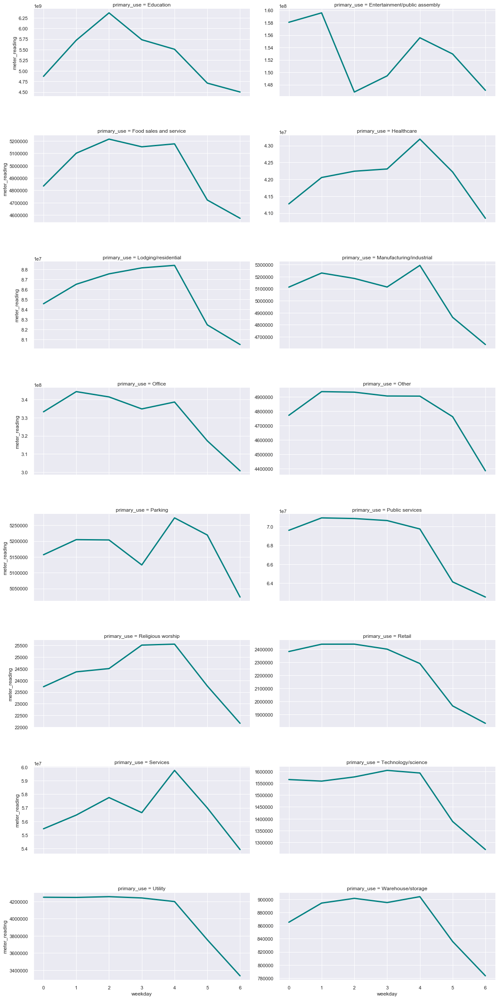

In [33]:
#lets check mean meter reading based on building type throuhout the week
plt.clf()
grouped = Train.groupby(['weekday', 'primary_use']).meter_reading.sum().reset_index()
ax = sns.FacetGrid(grouped, col="primary_use", col_wrap=2, height=4, aspect=2,  sharey=False)
ax.map(plt.plot, 'weekday', 'meter_reading', color="teal", linewidth = 3)
plt.subplots_adjust(hspace=0.45)
plt.show()

The trend for education is almost identical to the global trend. Additionally, the trend for Entertainment/public assembly is very different from the others. 
Lets find out why!

<Figure size 432x288 with 0 Axes>

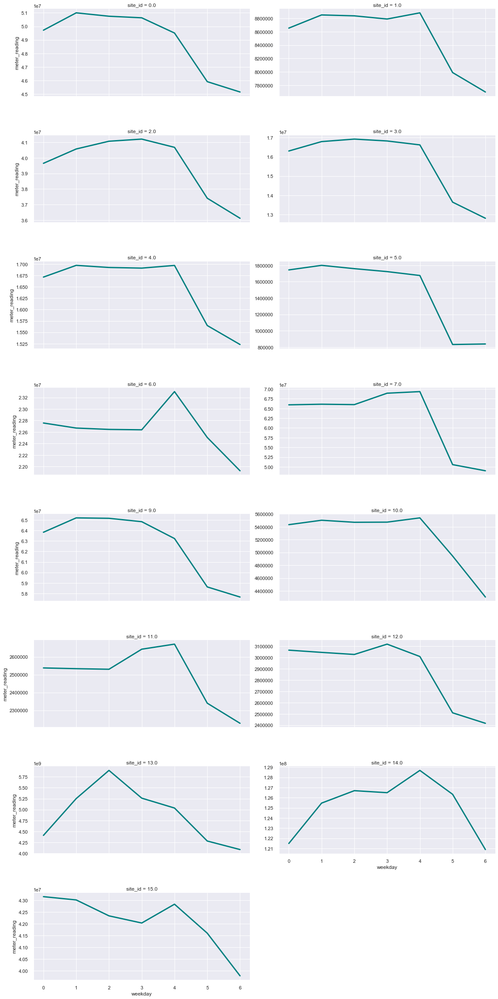

In [34]:
plt.clf()
grouped = Train.loc[(Train["primary_use"]=="Education")].groupby(['weekday', 'site_id']).meter_reading.sum().reset_index()
ax = sns.FacetGrid(grouped, col="site_id", col_wrap=2, height=4, aspect=2,  sharey=False)
ax.map(plt.plot, 'weekday', 'meter_reading', color="teal", linewidth = 3)
plt.subplots_adjust(hspace=0.45)
plt.show()

It is clear that site 13 causes this skewness. Lets enquire more!

<Figure size 432x288 with 0 Axes>

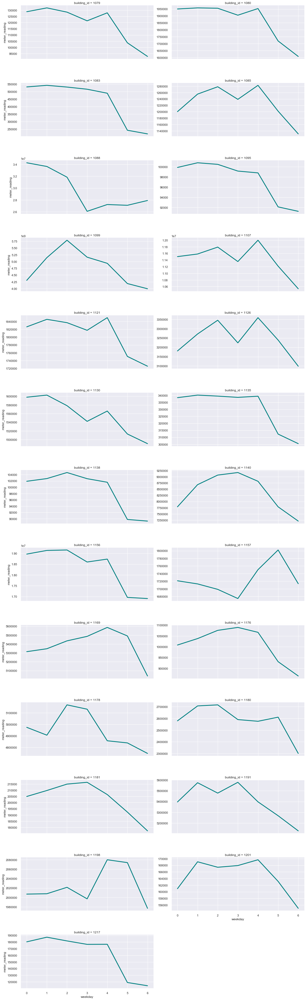

In [35]:
plt.clf()
grouped = Train.loc[(Train["primary_use"]=="Education") & (Train["site_id"]==13.0)].groupby(['weekday', 'building_id']).meter_reading.sum().reset_index()
ax = sns.FacetGrid(grouped, col="building_id", col_wrap=2, height=4, aspect=2,  sharey=False)
ax.map(plt.plot, 'weekday', 'meter_reading', color="teal", linewidth = 3)
plt.subplots_adjust(hspace=0.45)
plt.show()


building 1099 causes this skew.

<Figure size 432x288 with 0 Axes>

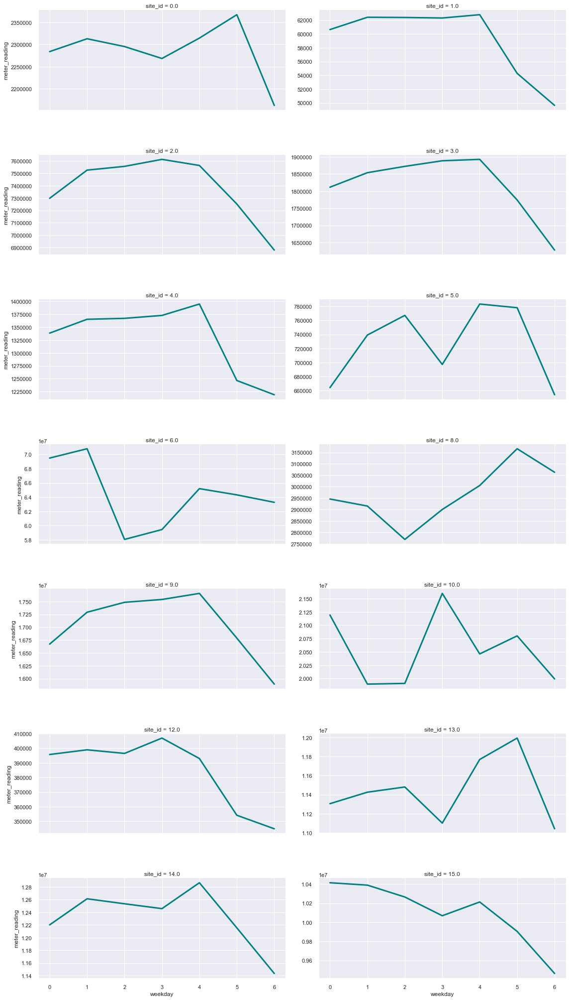

In [36]:
plt.clf()
grouped = Train.loc[(Train["primary_use"]=="Entertainment/public assembly")].groupby(['weekday', 'site_id']).meter_reading.sum().reset_index()
ax = sns.FacetGrid(grouped, col="site_id", col_wrap=2, height=4, aspect=2,  sharey=False)
ax.map(plt.plot, 'weekday', 'meter_reading', color="teal", linewidth = 3)
plt.subplots_adjust(hspace=0.45)
plt.show()

Site 6 has a similar pattern

<Figure size 432x288 with 0 Axes>

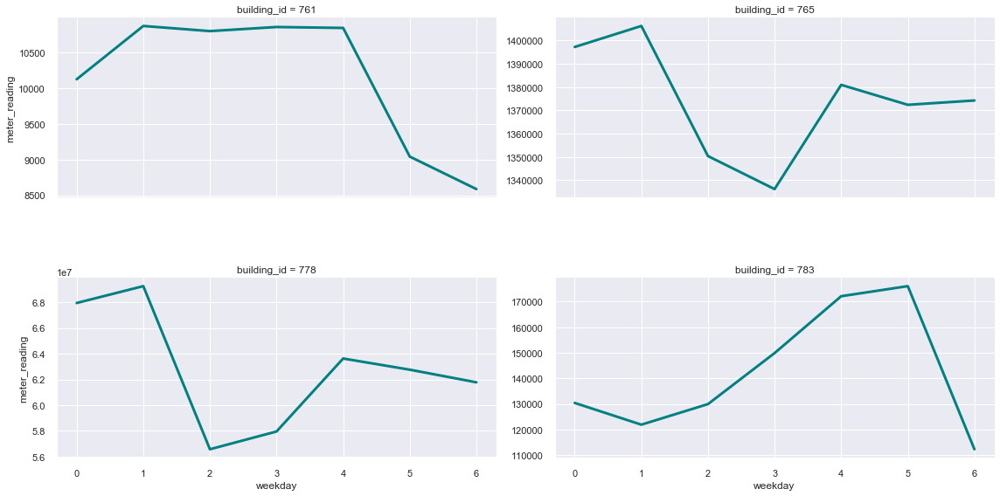

In [37]:
plt.clf()
grouped = Train.loc[(Train["primary_use"]=="Entertainment/public assembly") & (Train["site_id"]==6.0)].groupby(['weekday', 'building_id']).meter_reading.sum().reset_index()
ax = sns.FacetGrid(grouped, col="building_id", col_wrap=2, height=4, aspect=2,  sharey=False)
ax.map(plt.plot, 'weekday', 'meter_reading', color="teal", linewidth = 3)
plt.subplots_adjust(hspace=0.45)
plt.show()


building 765 and 778

### Explanatory Variables

#### Meter

<Figure size 432x288 with 0 Axes>

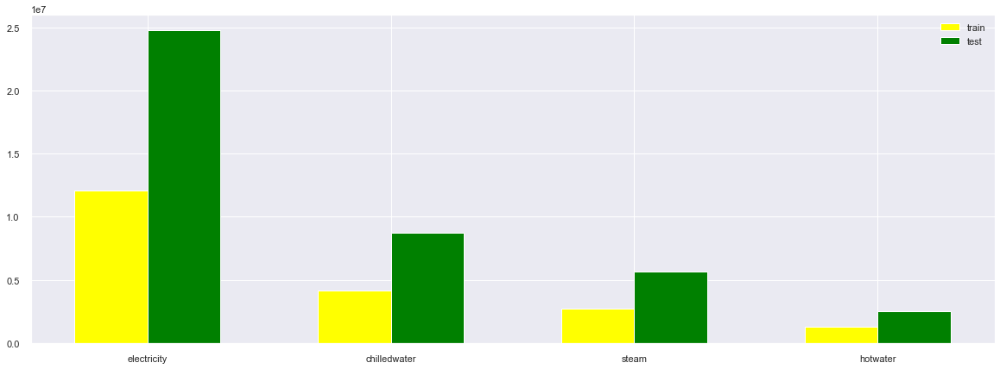

In [38]:
## Checking the distribution of meter types
plt.clf()
fig, ax = plt.subplots(1, 1, figsize = (20, 7))
trm = train["meter"].map(meter_type).value_counts()
tem = test["meter"].map(meter_type).value_counts()
ind = np.arange(4)
ax.bar(ind, trm.values, color = "yellow", width = 0.3, label = "train")
ax.bar(ind + 0.3, tem.values, color = "green", width = 0.3, label = "test")
ax.set_xticks(ind + 0.3 / 2)
ax.set_xticklabels(trm.index)
ax.legend()
plt.show()

#### site_id

<Figure size 432x288 with 0 Axes>

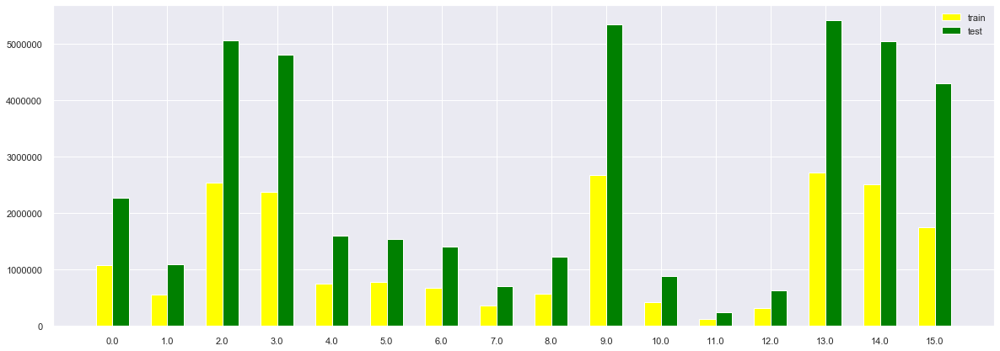

In [39]:
## Checking the distribution of meter types
plt.clf()
fig, ax = plt.subplots(1, 1, figsize = (20, 7))
trm = train["site_id"].value_counts().sort_index()
tem = test["site_id"].value_counts().sort_index()
# len(trm.index) == len(tem.index)
ind = np.arange(16)
ax.bar(ind, trm.values, color = "yellow", width = 0.3, label = "train")
ax.bar(ind + 0.3, tem.values, color = "green", width = 0.3, label = "test")
ax.set_xticks(ind + 0.3 / 2)
ax.set_xticklabels(trm.index)
ax.legend()
plt.show()

#### Year Built

In [40]:
'''Function to distribution plot'''
def distplot(variable, color):
    global ax
    font_size = 16
    title_size = 20
    plt.rcParams['figure.figsize'] = (10, 10)
    ax = sns.distplot(variable, color = color)
    plt.xlabel('%s' %variable.name, fontsize = font_size)
    plt.ylabel('Count ', fontsize = font_size)
    plt.xticks(fontsize = font_size)
    plt.yticks(fontsize = font_size)
    plt.title(' Distribution of '+'%s' %variable.name, fontsize = title_size)
    plt.show()

Text(0, 0.5, 'count')

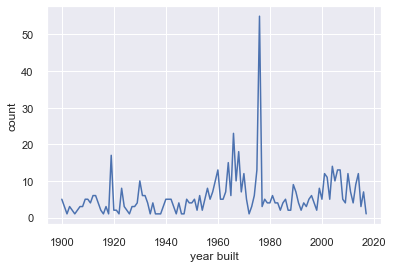

In [41]:
#distribution over the year the buildings were build
plt.clf()
grouped = Train.groupby('year_built').building_id.nunique().reset_index()
ax = sns.lineplot(data = grouped,x= 'year_built', y= 'building_id')
plt.xlabel('year built')
plt.ylabel('count')

#### Square Feet

Text(0.5, 1.0, 'Distribution of Square Feet')

<Figure size 432x288 with 0 Axes>

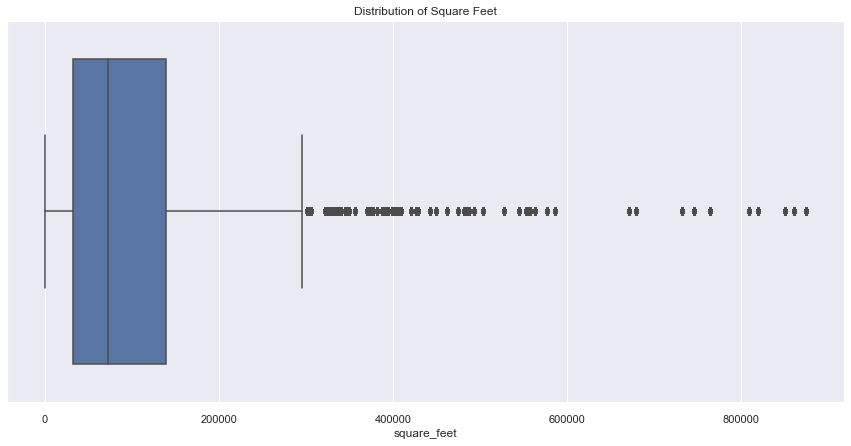

In [42]:
plt.clf()
fig, ax = plt.subplots(1,1,figsize = (15, 7))
sns.boxplot(x = train["square_feet"], ax = ax)
ax.set_title("Distribution of Square Feet")

#### Primary Use

<Figure size 432x288 with 0 Axes>

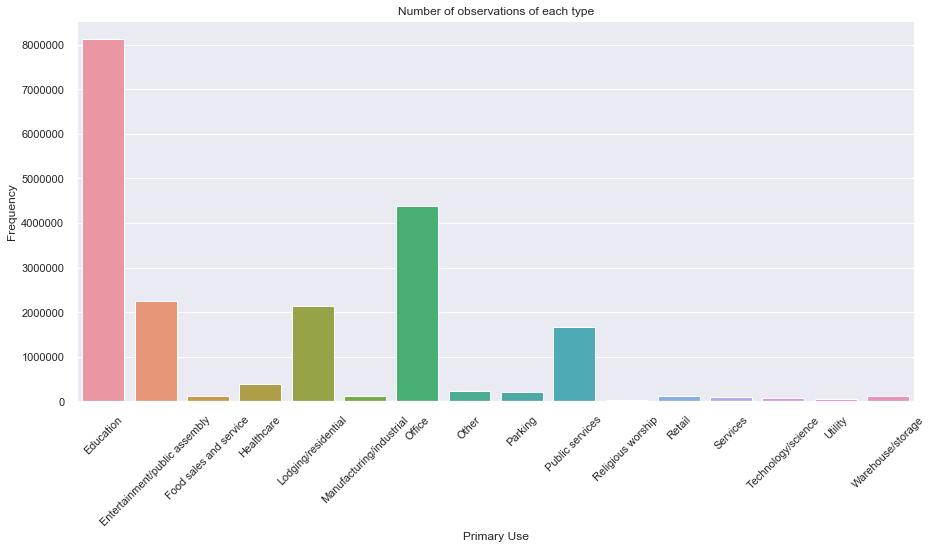

In [43]:
plt.clf()
pu_freq = train.groupby("primary_use")["primary_use"].apply(len)
fig, ax = plt.subplots(1, 1, figsize = (15, 7))
sns.barplot(x = pu_freq.index, y = pu_freq.values, ax = ax)
ax.set_title("Number of observations of each type")
ax.set_xlabel("Primary Use")
ax.set_ylabel("Frequency")
for tick in ax.get_xticklabels():
    tick.set_rotation(45)

#### Air Temperature

<Figure size 432x288 with 0 Axes>

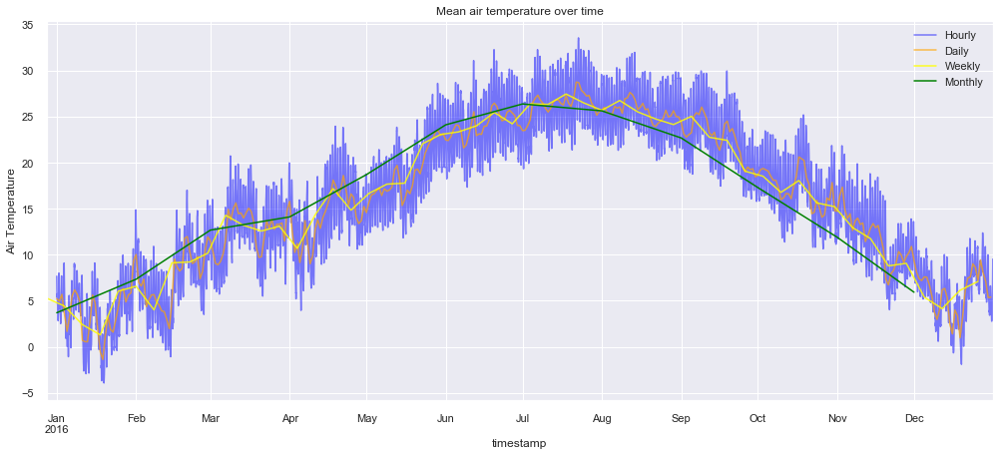

In [44]:
# Mean meter reading over time
plt.clf()
fig, ax = plt.subplots(figsize = (17, 7))
train[["timestamp", "air_temperature"]].set_index("timestamp").resample("H").mean()["air_temperature"].plot(ax = ax, label = "Hourly", color = "blue", alpha = 0.5)
train[["timestamp", "air_temperature"]].set_index("timestamp").resample("D").mean()["air_temperature"].plot(ax = ax, label = "Daily", color = "orange", alpha = 0.7)
train[["timestamp", "air_temperature"]].set_index("timestamp").resample("W").mean()["air_temperature"].plot(ax = ax, label = "Weekly", color = "yellow", alpha = 0.85)
train[["timestamp", "air_temperature"]].set_index("timestamp").resample("M").mean()["air_temperature"].plot(ax = ax, label = "Monthly", color = "green", alpha = 1)
ax.set_title("Mean air temperature over time")
ax.set_ylabel("Air Temperature")
ax.legend(loc = "best")

#### Dew Temperature

<Figure size 432x288 with 0 Axes>

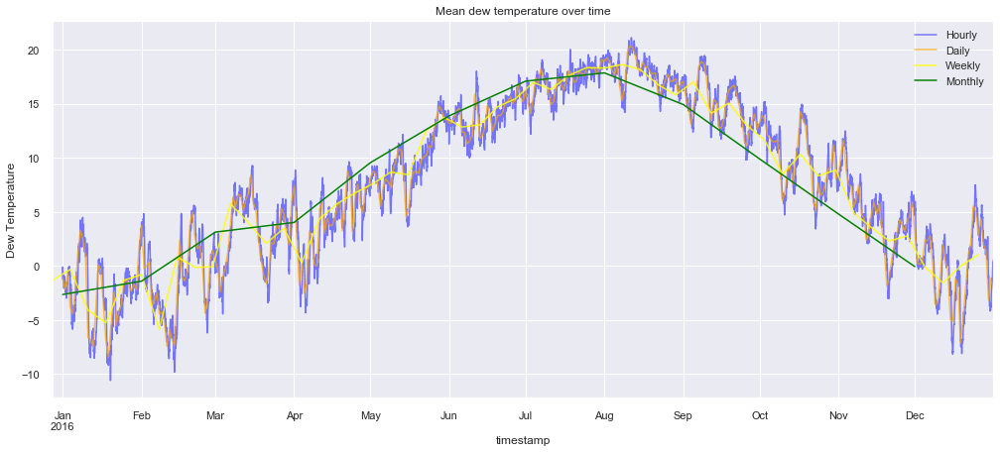

In [45]:
# Mean meter reading over time
plt.clf()
fig, ax = plt.subplots(figsize = (17, 7))
train[["timestamp", "dew_temperature"]].set_index("timestamp").resample("H").mean()["dew_temperature"].plot(ax = ax, label = "Hourly", color = "blue", alpha = 0.5)
train[["timestamp", "dew_temperature"]].set_index("timestamp").resample("D").mean()["dew_temperature"].plot(ax = ax, label = "Daily", color = "orange", alpha = 0.7)
train[["timestamp", "dew_temperature"]].set_index("timestamp").resample("W").mean()["dew_temperature"].plot(ax = ax, label = "Weekly", color = "yellow", alpha = 0.85)
train[["timestamp", "dew_temperature"]].set_index("timestamp").resample("M").mean()["dew_temperature"].plot(ax = ax, label = "Monthly", color = "green", alpha = 1)
ax.set_title("Mean dew temperature over time")
ax.set_ylabel("Dew Temperature")
ax.legend(loc = "best")

#### Sea Level Pressure

<Figure size 432x288 with 0 Axes>

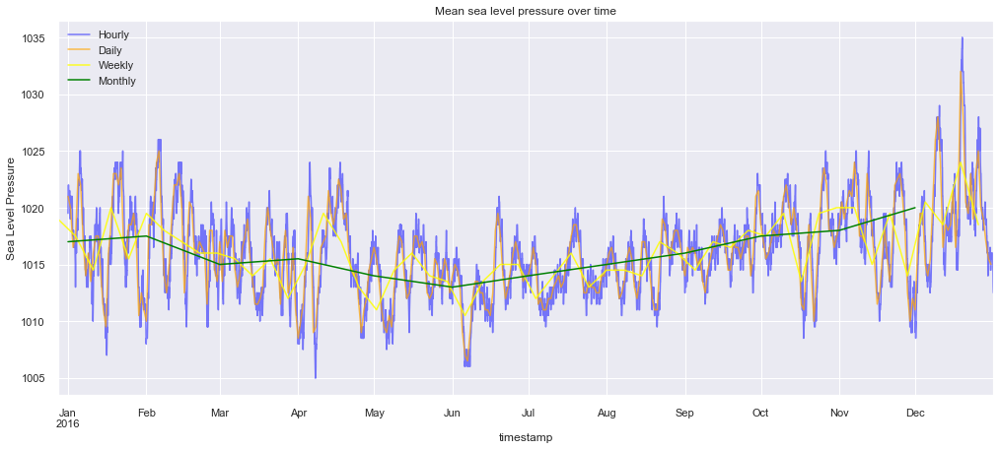

In [46]:
# Mean meter reading over time
plt.clf()
fig, ax = plt.subplots(figsize = (17, 7))
train[["timestamp", "sea_level_pressure"]].set_index("timestamp").resample("H").mean()["sea_level_pressure"].plot(ax = ax, label = "Hourly", color = "blue", alpha = 0.5)
train[["timestamp", "sea_level_pressure"]].set_index("timestamp").resample("D").mean()["sea_level_pressure"].plot(ax = ax, label = "Daily", color = "orange", alpha = 0.7)
train[["timestamp", "sea_level_pressure"]].set_index("timestamp").resample("W").mean()["sea_level_pressure"].plot(ax = ax, label = "Weekly", color = "yellow", alpha = 0.85)
train[["timestamp", "sea_level_pressure"]].set_index("timestamp").resample("M").mean()["sea_level_pressure"].plot(ax = ax, label = "Monthly", color = "green", alpha = 1)
ax.set_title("Mean sea level pressure over time")
ax.set_ylabel("Sea Level Pressure")
ax.legend(loc = "best")

#### Precipitation

<Figure size 432x288 with 0 Axes>

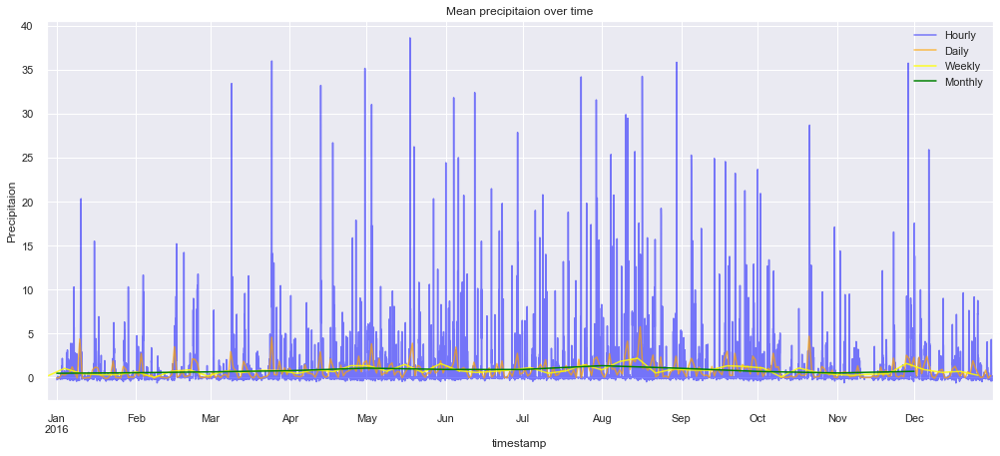

In [47]:
# Mean meter reading over time
plt.clf()
fig, ax = plt.subplots(figsize = (17, 7))
train[["timestamp", "precip_depth_1_hr"]].set_index("timestamp").resample("H").mean()["precip_depth_1_hr"].plot(ax = ax, label = "Hourly", color = "blue", alpha = 0.5)
train[["timestamp", "precip_depth_1_hr"]].set_index("timestamp").resample("D").mean()["precip_depth_1_hr"].plot(ax = ax, label = "Daily", color = "orange", alpha = 0.7)
train[["timestamp", "precip_depth_1_hr"]].set_index("timestamp").resample("W").mean()["precip_depth_1_hr"].plot(ax = ax, label = "Weekly", color = "yellow", alpha = 0.85)
train[["timestamp", "precip_depth_1_hr"]].set_index("timestamp").resample("M").mean()["precip_depth_1_hr"].plot(ax = ax, label = "Monthly", color = "green", alpha = 1)
ax.set_title("Mean precipitaion over time")
ax.set_ylabel("Precipitaion")
ax.legend(loc = "best")

# Analysis

For this project, we are just considering the meter reading of electricity meter due to high volume of data. We are going to do a three step analysis:
1. We will try to see the affect of building configuration/metadata on meter reading.
2. We will incorporate weather and time information and see how these variables, along with the building metadata, affect meter reading
3. We will try some complicated model, LightGBM, and see how it fares with the previous simple linear models

## Preparing Data for Analysis

Since this dataset was taken from a kaggle competition, we don't have meter_readings available for the test dataset. Hence, we will split the train dataset into training set and validation set; the former will be used for training whereas the latter will be used to check the performance of models.

In [48]:
# Deleting the test dataset
del test, Train, Test

# Garbage collection
gc.collect()

217

### Subsetting dataset to get rows for meter == "electricity"(0)

In [5]:
# Electricity meter readings
train = train[train["meter"] == 0]

### Adding Time Data

In [6]:
# Weekday
train["day"] = train["timestamp"].dt.weekday

# Month
train["month"] = train["timestamp"].dt.month

# Holidays
holidays = ["2016-01-01", "2016-01-18", "2016-02-15", "2016-05-30", "2016-07-04",
                    "2016-09-05", "2016-10-10", "2016-11-11", "2016-11-24", "2016-12-26",
                    "2017-01-02", "2017-01-16", "2017-02-20", "2017-05-29", "2017-07-04",
                    "2017-09-04", "2017-10-09", "2017-11-10", "2017-11-23", "2017-12-25",
                    "2018-01-01", "2018-01-15", "2018-02-19", "2018-05-28", "2018-07-04",
                    "2018-09-03", "2018-10-08", "2018-11-12", "2018-11-22", "2018-12-25",
                    "2019-01-01"]
train["is_holiday"] = (train.timestamp.isin(holidays)).astype(int)

### Missing Data

#### Building Metadata

##### Square Feat

In [7]:
print("Percentage of data with NA in square feet:", train["square_feet"].isna().sum()*100/len(train))

Percentage of data with NA in square feet: 0.36068588522756573


We know that the square feet value for a building will be same for the entire dataset, unless the building was renovated sometime during the time period for which the data is available, hence we can impute missing values with either the unique square feet value of the building or mean of square feat value. 

In [8]:
na_count = train.groupby("building_id")[["square_feet"]].apply(lambda x: x.isna().sum()/len(x)).squeeze()
print("Buildings with no data for square feet: %d", len(na_count[na_count == 1]))

Buildings with no data for square feet: %d 0


As we can see, that for every building there's atleast one record that contains the square feet value of the building. We will check now if the square feet value is unique for a particular building.

In [9]:
unique_count = train.groupby("building_id")[["square_feet"]].apply(lambda x: x.nunique()).squeeze()
print("Buildings with more than 1 value for square feet", len(unique_count[unique_count != 1]))

Buildings with more than 1 value for square feet 0


Since each building has only one square feet value, we can easily impute the missing values. As we saw above in the boxplot for square_feet, all the values are greater than or equal to 0, that is, all square_feet values are legal.

In [10]:
sf_na_mapping = train.groupby("building_id")[["square_feet"]].apply(lambda x: x.max()).squeeze()
for bid in sf_na_mapping.index:
    train.loc[train["building_id"] == bid, "square_feet"] = sf_na_mapping[bid]

##### Primary Use

In [11]:
print("Percentage of data with NA in primary use: %d", train["primary_use"].isna().sum()*100/len(train))

Percentage of data with NA in primary use: %d 0.36068588522756573


We know that the primary value for a building will be same for the entire dataset hence we can impute missing values with the unique primary use value of the building.

In [12]:
na_count = train.groupby("building_id")[["primary_use"]].apply(lambda x: x.isna().sum()/len(x)).squeeze()
print("Buildings with no data for primary_use: %d", len(na_count[na_count == 1]))

Buildings with no data for primary_use: %d 0


As we can see, that for every building there's atleast one record that contains the primary use value of the building. We will check now if the primary use value is unique for a particular building.

In [13]:
unique_count = train.groupby("building_id")[["primary_use"]].apply(lambda x: x.nunique()).squeeze()
print("Buildings with more than 1 value for primary use", len(unique_count[unique_count != 1]))

Buildings with more than 1 value for primary use 0


Since each building has only one primary use value, we can easily impute the missing values.

In [14]:
pu_na_mapping = train.groupby("building_id")[["primary_use"]].apply(lambda x: pd.DataFrame(x.max())).reset_index(level = 1, drop = True).squeeze()
for bid in pu_na_mapping.index:
    train.loc[train["building_id"] == bid, "primary_use"] = pu_na_mapping[bid]

##### Floor Count

In [15]:
print("Percentage of data with NA in floor count: %d", train["floor_count"].isna().sum()*100/len(train))

Percentage of data with NA in floor count: %d 75.46836018177733


Since about $\frac{3}{4}$ of the records have missing data for floor count, we might have to drop this column.

In [16]:
na_count = train.groupby("building_id")[["floor_count"]].apply(lambda x: x.isna().sum()/len(x)).squeeze()
print("Buildings with no data for floor count: %d", len(na_count[na_count == 1]))

Buildings with no data for floor count: %d 1061


As we can see more than a thousand buildings, out of a total of about 1500 buildings for which the dataset has meter_reading records, don't have any information for floor count. Hence, we have decided to drop this field from the dataset for analysis.

##### Year Built

In [17]:
print("Percentage of data with NA in year built: %d", train["year_built"].isna().sum()*100/len(train))

Percentage of data with NA in year built: %d 53.94482671705535


Since about $\frac{1}{2}$ of the records have missing data for floor count, we might have to drop this column.

In [18]:
na_count = train.groupby("building_id")[["year_built"]].apply(lambda x: x.isna().sum()/len(x)).squeeze()
print("Buildings with no data for year_built: %d", len(na_count[na_count == 1]))

Buildings with no data for year_built: %d 750


As we can 750 buildings, out of a total of about 1500 buildings for which the dataset has meter_reading records, don't have any information for year built. Hence, we have decided to drop this field from the dataset for analysis.

#### Weather Data

Since the weather data follows time-series, we will sort the dataset by timestamp for easier imputation

In [19]:
train.sort_values(by = "timestamp", axis = 0, inplace = True)

##### Air Temperature

In [20]:
print("Percentage of data with NA in air temperature: {0}".format(train["air_temperature"].isna().sum()*100/len(train)))

Percentage of data with NA in air temperature: 0.3923833276261907


In [21]:
train.loc[train["air_temperature"].isna(), "timestamp"].nunique()

515

We will use forward fill to fill in missing values since air temperature is highly correlated on hourly basis.

##### Cloud Coverage

In [22]:
print("Percentage of data with NA in cloud coverage: {0}".format(train["cloud_coverage"].isna().sum()*100/len(train)))

Percentage of data with NA in cloud coverage: 44.18946829053529


The amount of missing data is too much so we have decided to drop this field.

##### Dew Temperature

In [23]:
print("Percentage of data with NA in dew temperature: {0}".format(train["dew_temperature"].isna().sum()*100/len(train)))

Percentage of data with NA in dew temperature: 0.40702567219223096


Following the same argument as air temperature, we have just dropped records where values are missing.

##### Precipitation

We saw above that precipitation value for some records is below 0 which is not a legal value and hence all these values will be replaced by NaN.

In [28]:
train.loc[train["precip_depth_1_hr"] < 0, "precip_depth_1_hr"] = None

In [29]:
print("Percentage of data with NA in precipitation: {0}".format(train["precip_depth_1_hr"].isna().sum()*100/len(train)))

Percentage of data with NA in precipitation: 26.072924845637683


We will use forward fill method to fill in missing values since precipitation is highly correlated for a given day.

##### Sea Level Pressure

In [25]:
print("Percentage of data with NA in sea level pressure: {0}".format(train["sea_level_pressure"].isna().sum()*100/len(train)))

Percentage of data with NA in sea level pressure: 8.443666356850354


Following the argument with precipitation, we will use forward fill to fill in missing values.

##### Wind Direction

In [26]:
print("Percentage of data with NA in wind direction: {0}".format(train["wind_direction"].isna().sum()*100/len(train)))

Percentage of data with NA in wind direction: 5.627394616160804


##### Wind Speed

In [27]:
print("Percentage of data with NA in wind speed: {0}".format(train["wind_speed"].isna().sum()*100/len(train)))

Percentage of data with NA in wind speed: 0.5538139327795332


We are not considering wind related data for analysis since we think that these fields have little to no affect on energy consumption.

In [32]:
train.update(train[["air_temperature", "dew_temperature", "sea_level_pressure", "precip_depth_1_hr"]].fillna(method='ffill'), overwrite = False)
train.dropna(subset = ["air_temperature", "dew_temperature", "sea_level_pressure", "precip_depth_1_hr"], axis = 0, inplace = True)

### Subsetting dataset to keep necessary columns

In [35]:
train = train[["meter_reading", "primary_use", "square_feet", "air_temperature", "dew_temperature", "sea_level_pressure", "precip_depth_1_hr", "day", "is_holiday", "month"]]

In [37]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12059522 entries, 3567 to 20216099
Data columns (total 10 columns):
meter_reading         float32
primary_use           object
square_feet           float64
air_temperature       float32
dew_temperature       float32
sea_level_pressure    float32
precip_depth_1_hr     float32
day                   int64
is_holiday            int32
month                 int64
dtypes: float32(5), float64(1), int32(1), int64(2), object(1)
memory usage: 736.1+ MB


### Outlier Removal

In [38]:
old_len = len(train)

In [39]:
numerical_cols = ["meter_reading", "square_feet", "air_temperature", "dew_temperature", "sea_level_pressure", "precip_depth_1_hr"]
train = train[(np.abs(stats.zscore(train[numerical_cols])) < 3).all(axis=1)]

In [43]:
print("Percentage of data removed as outlier: ", round((old_len - len(train))*100/old_len, 2))

Percentage of data removed as outlier:  5.11


### Scaling

In [46]:
scaler = StandardScaler()
train.update(pd.DataFrame(scaler.fit_transform(train[numerical_cols]), columns=numerical_cols))

### Taking log transformation on target variable

In [47]:
train["meter_reading"] = np.log1p(train["meter_reading"])

### Correlation

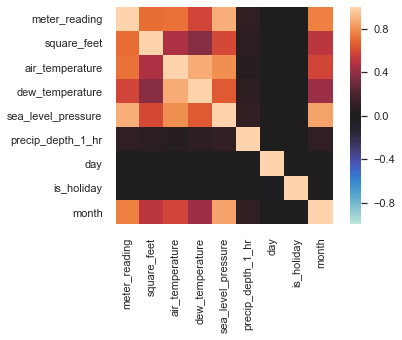

In [48]:
plt.clf()
plt.rcParams['figure.figsize'] = (10,10)
sns.heatmap(train.corr(), vmin=-1, vmax=1, center=0,square=True)
plt.show()

### Splitting the datset

In [49]:
# Train validation split
train, valid = train_test_split(train, train_size = 0.8)

### Modeling

In [125]:
# Helper function for residual plot
def plot_residual(model, valid_data, features):
    plt.clf()
    fig, ax = plt.subplots(1, 1, figsize = (10, 10))
    visualizer = ResidualsPlot(model, is_fitted = True, ax = ax)
    visualizer.score(valid_data.drop("meter_reading", axis = 1), valid_data["meter_reading"])
    features = "Features: "+",".join(features)
    ax.set_title(r'{\fontsize{30pt}{3em}\selectfont{}{Residuals for BayesianRidge Model\n}{\fontsize{18pt}{3em}\selectfont{}(features)}')
    visualizer.show()
    plt.show()

    del visualizer
    gc.collect()

In [126]:
# Helper function to plot prediction error
def plot_prederror(model, valid_data, features):
    plt.clf()
    fig, ax = plt.subplots(1, 1, figsize = (10, 10))
    visualizer = PredictionError(model, is_fitted = True, ax = ax)
    visualizer.score(valid_data.drop("meter_reading", axis = 1), valid_data["meter_reading"])
    features = "Features: "+",".join(features)
    ax.set_title(r'{\fontsize{30pt}{3em}\selectfont{}{Prediction Error for BayesianRidge\n}{\fontsize{18pt}{3em}\selectfont{}(features)}')
    visualizer.show()
    plt.show()

    del visualizer
    gc.collect()

#### Building Metadata Vs. Meter Reading

##### Meter reading from primary use of building

In [127]:
train_pu = train[["meter_reading", "primary_use"]]
valid_pu = valid[["meter_reading", "primary_use"]]
train_pu_d = pd.get_dummies(train_pu)
valid_pu_d = pd.get_dummies(valid_pu)

In [128]:
model_pu = LinearRegression(fit_intercept = False)
model_pu.fit(train_pu_d.drop("meter_reading", axis = 1), train_pu_d["meter_reading"])

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

In [129]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_pu_d.columns[1:], model_pu.coef_)})

Model Coefficients:
{'primary_use_Education': 1.7057454555003106,
 'primary_use_Entertainment/public assembly': 1.2984794312889951,
 'primary_use_Food sales and service': 1.7205919389541022,
 'primary_use_Healthcare': 1.7153404446437763,
 'primary_use_Lodging/residential': 1.674097634583894,
 'primary_use_Manufacturing/industrial': 1.5405910437579968,
 'primary_use_Office': 1.6037999657094446,
 'primary_use_Other': 1.0354865736361247,
 'primary_use_Parking': 1.52301295041694,
 'primary_use_Public services': 1.3921162824947166,
 'primary_use_Religious worship': 0.4996035852744819,
 'primary_use_Retail': 1.33895677730615,
 'primary_use_Services': 1.6076673601848186,
 'primary_use_Technology/science': 1.702039302696816,
 'primary_use_Utility': 1.8433386046617737,
 'primary_use_Warehouse/storage': 1.2339717555291116}


<Figure size 720x720 with 0 Axes>

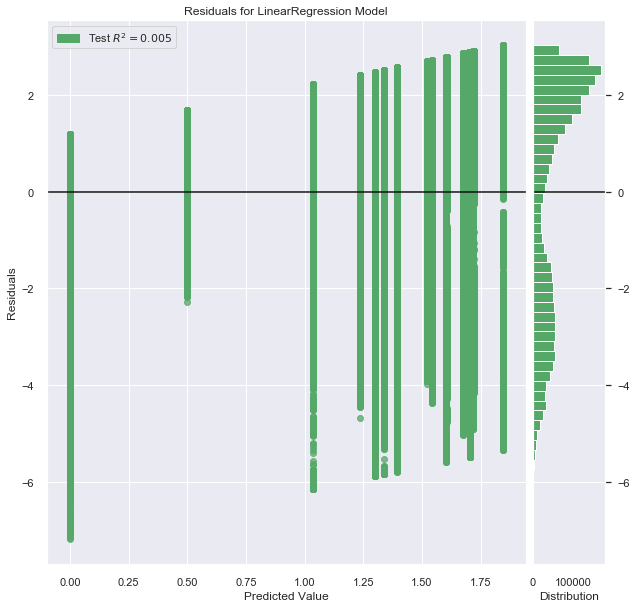

In [130]:
# Residual Plot
plot_residual(model_pu, valid_pu_d, ["Primary Use"])

<Figure size 720x720 with 0 Axes>

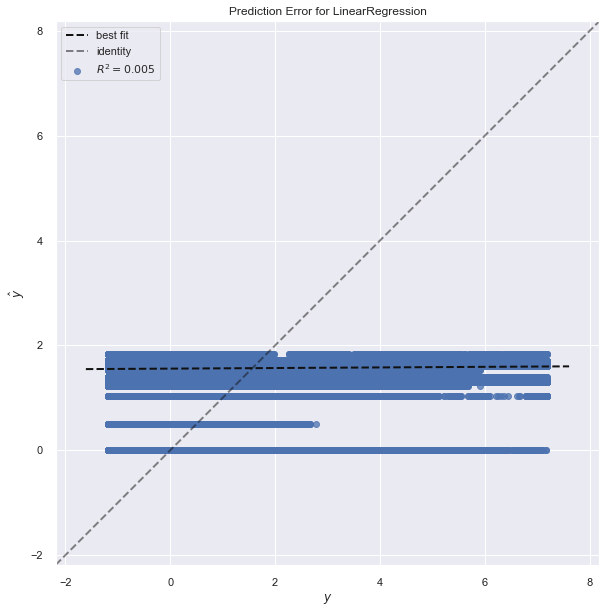

In [131]:
# Prediction error
plot_prederror(model_pu, valid_pu_d, ["Primary Use"])

In [132]:
del model_pu, train_pu, valid_pu, train_pu_d, valid_pu_d

gc.collect()

2901

##### Meter reading using square feet

In [133]:
train_sf = train[["meter_reading", "square_feet"]]
valid_sf = valid[["meter_reading", "square_feet"]]

In [134]:
model_sf = LinearRegression(fit_intercept = False)

model_sf.fit(train_sf.drop("meter_reading", axis = 1), train_sf["meter_reading"])

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

In [135]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_sf.columns[1:], model_sf.coef_)})

Model Coefficients:
{'square_feet': 3.020884141367962e-05}


<Figure size 720x720 with 0 Axes>

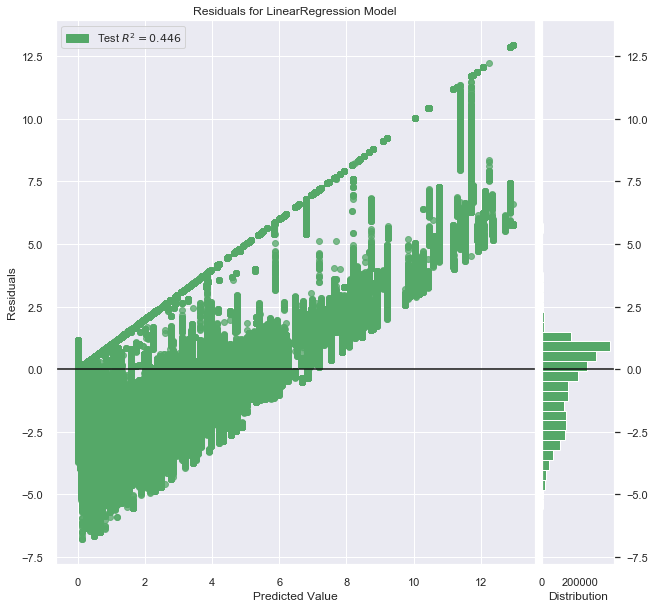

In [136]:
# PLot Residual
plot_residual(model_sf, valid_sf, ["Square Feet"])

<Figure size 720x720 with 0 Axes>

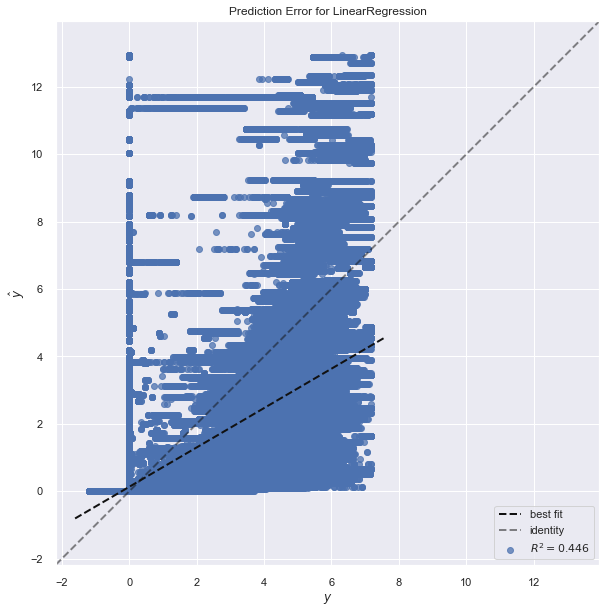

In [137]:
# PLot Prediction Error
plot_prederror(model_sf, valid_sf, ["Square Feet"])

In [138]:
del model_sf, train_sf, valid_sf

gc.collect()

3115

##### Meter reading using both square feet and primary reading (without interaction)

In [139]:
train_bm = train[["meter_reading", "square_feet" ,"primary_use"]]
valid_bm = valid[["meter_reading", "square_feet","primary_use"]]

train_bm_d = pd.get_dummies(train_bm)
valid_bm_d = pd.get_dummies(valid_bm)

In [140]:
model_bm = LinearRegression(fit_intercept=False)
model_bm.fit(train_bm_d.drop("meter_reading", axis = 1), train_bm_d["meter_reading"])  

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

In [141]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_bm_d.columns[1:], model_bm.coef_)})

Model Coefficients:
{'primary_use_Education': 0.5918756829670447,
 'primary_use_Entertainment/public assembly': 0.5796545259691875,
 'primary_use_Food sales and service': 1.2813183589455026,
 'primary_use_Healthcare': 0.7467331381377359,
 'primary_use_Lodging/residential': 0.76083311706213,
 'primary_use_Manufacturing/industrial': 1.0179032496957348,
 'primary_use_Office': 0.7626859130494515,
 'primary_use_Other': 0.7096174076692049,
 'primary_use_Parking': -1.2429908147531485,
 'primary_use_Public services': 0.7622419635273847,
 'primary_use_Religious worship': 0.37030704829988326,
 'primary_use_Retail': 0.9975650241141677,
 'primary_use_Services': -0.5616277974995796,
 'primary_use_Technology/science': 1.1575795726265137,
 'primary_use_Utility': 1.468003990456597,
 'primary_use_Warehouse/storage': 0.6788585255896711,
 'square_feet': 2.670531155706804e-05}


<Figure size 720x720 with 0 Axes>

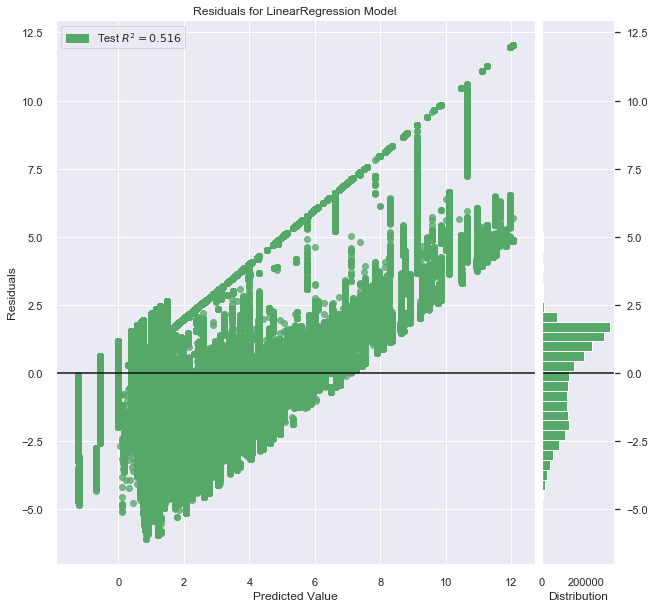

In [142]:
# PLot Residual
plot_residual(model_bm, valid_bm_d, ["Square Feet", "Primary Use"])

<Figure size 720x720 with 0 Axes>

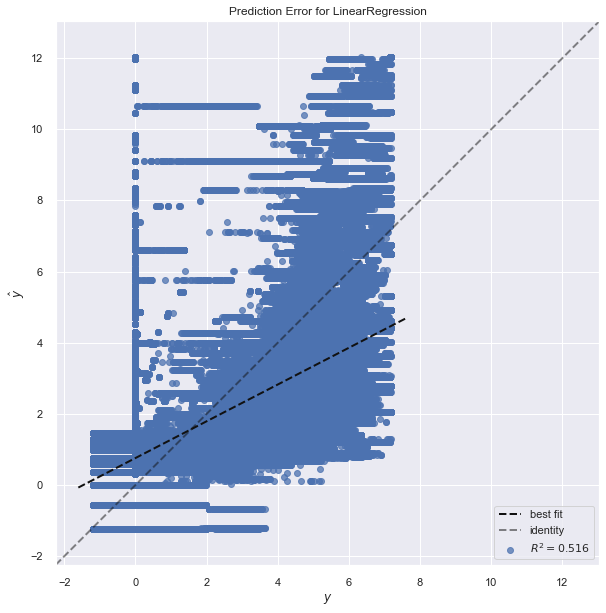

In [143]:
# PLot Prediction Error
plot_prederror(model_bm, valid_bm_d, ["Square Feet", "Primary Use"])

In [144]:
del model_bm, train_bm, valid_bm, train_bm_d, valid_bm_d

gc.collect()

3129

##### Meter reading using sea_level_pressure

In [145]:
train_slp = train[["meter_reading", "sea_level_pressure"]]
valid_slp = valid[["meter_reading", "sea_level_pressure"]]

In [146]:
model_slp = LinearRegression(fit_intercept=False)
model_slp.fit(train_slp.drop("meter_reading", axis = 1), train_slp["meter_reading"])  

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

In [147]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_slp.columns[1:], model_slp.coef_)})

Model Coefficients:
{'sea_level_pressure': 0.003978222301504993}


<Figure size 720x720 with 0 Axes>

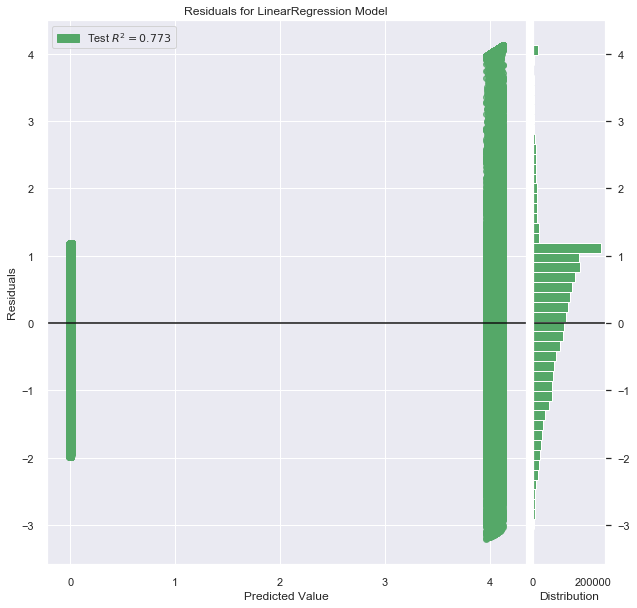

In [148]:
# PLot Residual
plot_residual(model_slp, valid_slp, ["Sea Level Pressure"])

<Figure size 720x720 with 0 Axes>

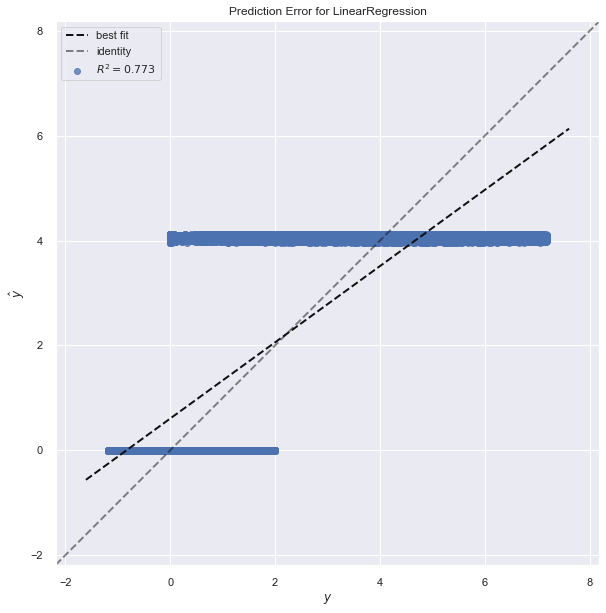

In [149]:
# PLot Prediction Error
plot_prederror(model_slp, valid_slp, ["Sea Level Pressure"])

In [150]:
del model_slp, train_slp, valid_slp
gc.collect()

2887

##### Meter reading using precip_depth_1_hr

In [151]:
train_pd1h = train[["meter_reading", "precip_depth_1_hr"]]
valid_pd1h = valid[["meter_reading", "precip_depth_1_hr"]]

In [152]:
model_pd1h = LinearRegression(fit_intercept=False)
model_pd1h.fit(train_pd1h.drop("meter_reading", axis = 1), train_pd1h["meter_reading"])  

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

In [153]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_pd1h.columns[1:], model_pd1h.coef_)})

Model Coefficients:
{'precip_depth_1_hr': 0.263349512248837}


<Figure size 720x720 with 0 Axes>

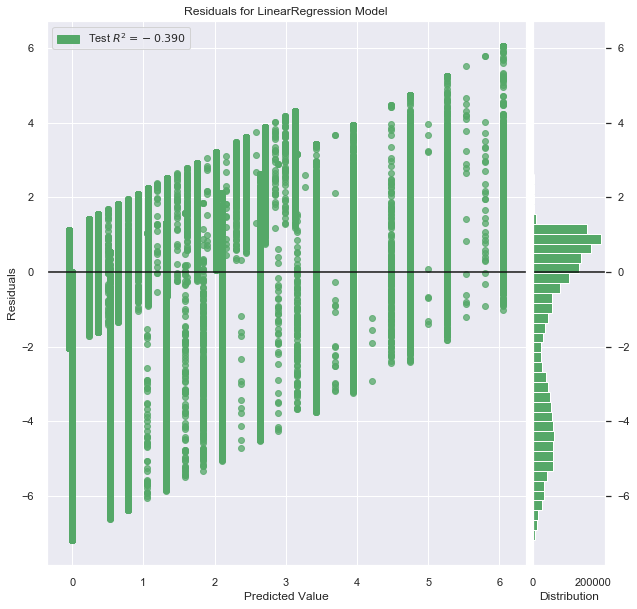

In [154]:
# PLot Residual
plot_residual(model_pd1h, valid_pd1h, ["Precipitation"])

<Figure size 720x720 with 0 Axes>

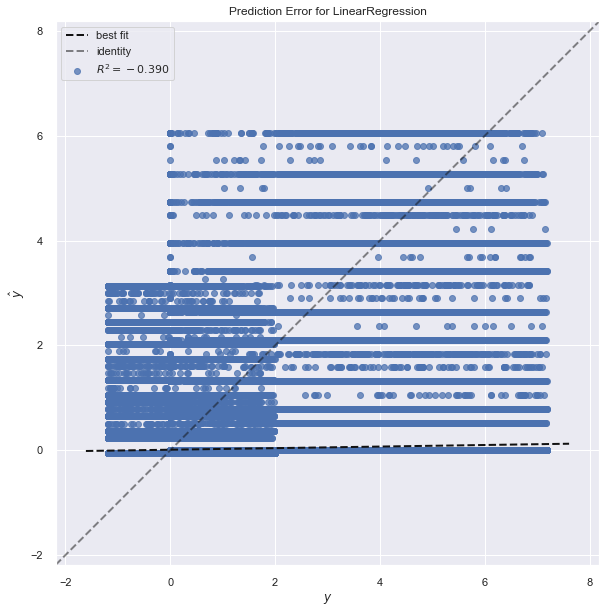

In [155]:
# PLot Prediction Error
plot_prederror(model_pd1h, valid_pd1h, ["Precipitaion"])

In [156]:
del model_pd1h, train_pd1h, valid_pd1h
gc.collect()

2887

##### Meter reading using dew temperature 

In [157]:
train_dt = train[["meter_reading", "dew_temperature"]]
valid_dt = valid[["meter_reading", "dew_temperature"]]

In [158]:
model_dt = LinearRegression(fit_intercept=False)
model_dt.fit(train_dt.drop("meter_reading", axis = 1), train_dt["meter_reading"])  

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

In [159]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_dt.columns[1:], model_dt.coef_)})

Model Coefficients:
{'dew_temperature': 0.22203186682134002}


<Figure size 720x720 with 0 Axes>

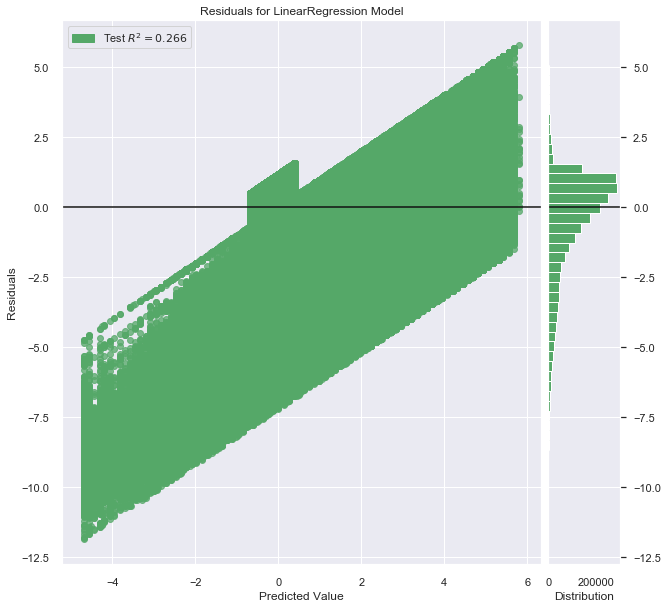

In [160]:
# PLot Residual
plot_residual(model_dt, valid_dt, ["Dew Temperature"])

<Figure size 720x720 with 0 Axes>

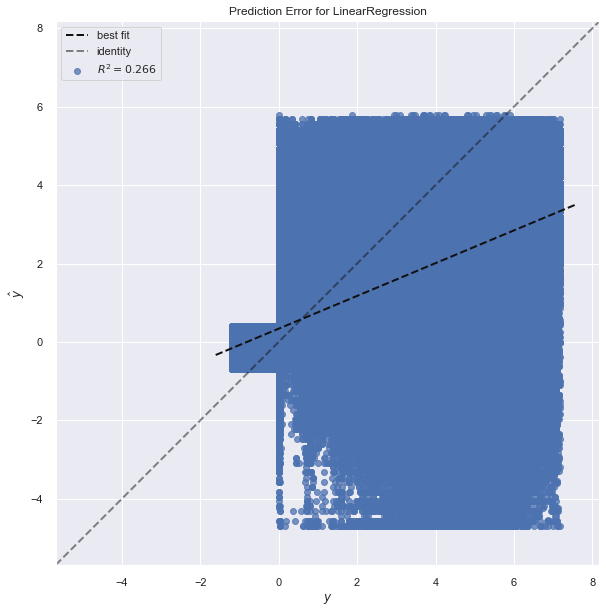

In [161]:
# PLot Prediction Error
plot_prederror(model_dt, valid_dt, ["Dew Temperature"])

In [162]:
del model_dt, train_dt, valid_dt
gc.collect()

3001

##### Meter reading using air_temperature

In [163]:
train_at = train[["meter_reading", "air_temperature"]]
valid_at = valid[["meter_reading", "air_temperature"]]

In [164]:
model_at = LinearRegression(fit_intercept=False)
model_at.fit(train_at.drop("meter_reading", axis = 1), train_at["meter_reading"])  

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

In [165]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_at.columns[1:], model_at.coef_)})

Model Coefficients:
{'air_temperature': 0.18070483197598614}


<Figure size 720x720 with 0 Axes>

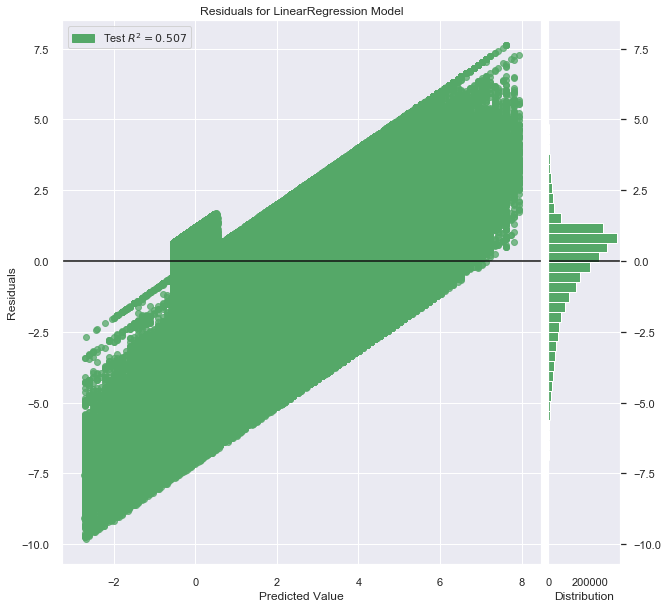

In [166]:
# PLot Residual
plot_residual(model_at, valid_at, ["Air Temperature"])

<Figure size 720x720 with 0 Axes>

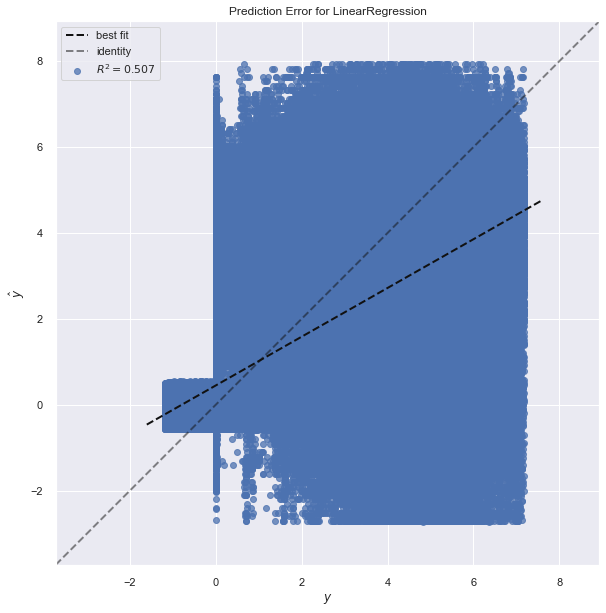

In [167]:
# PLot Prediction Error
plot_prederror(model_at, valid_at, ["Air Temperature"])

In [168]:
del model_at, train_at, valid_at
gc.collect()

2887

##### Meter reading using all weather variables (without interaction)

In [169]:
train_w = train[["meter_reading",  "precip_depth_1_hr", "dew_temperature","air_temperature", "sea_level_pressure"]]
valid_w = valid[["meter_reading",  "precip_depth_1_hr", "dew_temperature","air_temperature", "sea_level_pressure"]]

In [170]:
model_w = LinearRegression(fit_intercept=False)
model_w.fit(train_w.drop("meter_reading", axis = 1), train_w["meter_reading"])  

BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, compute_score=False, copy_X=True,
              fit_intercept=False, lambda_1=1e-06, lambda_2=1e-06, n_iter=300,
              normalize=False, tol=0.001, verbose=False)

In [171]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_w.columns[1:], model_w.coef_)})

Model Coefficients:
{'air_temperature': 0.017050353522601536,
 'dew_temperature': -0.010481019470948594,
 'precip_depth_1_hr': 0.010705308158615756,
 'sea_level_pressure': 0.003794301878555807}


<Figure size 720x720 with 0 Axes>

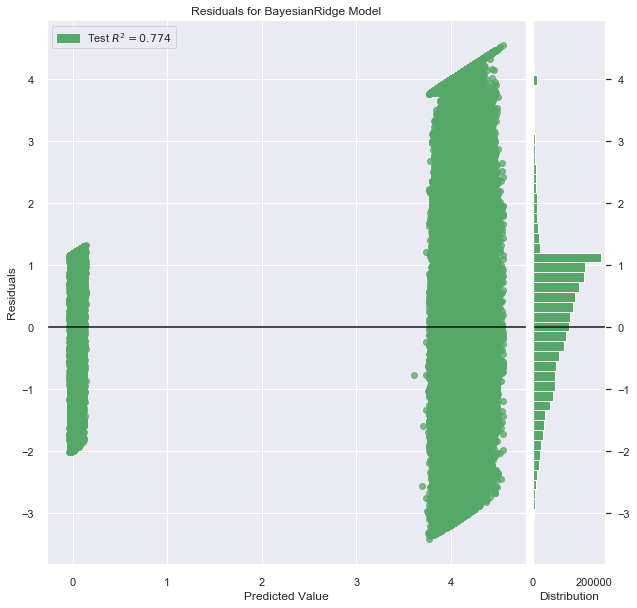

In [172]:
# PLot Residual
plot_residual(model_w, valid_w, ["Precipitation", "Dew Temperature", "Air Temperature", "Sea Level Pressure"])

<Figure size 720x720 with 0 Axes>

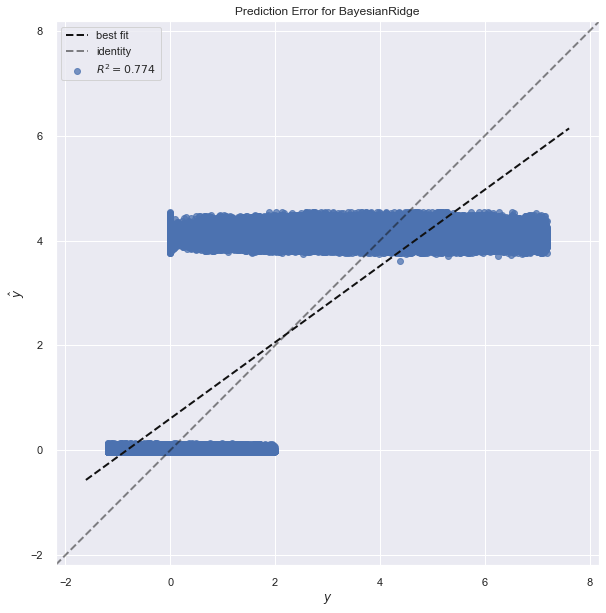

In [173]:
# PLot Prediction Error
plot_prederror(model_w, valid_w, ["Precipitation", "Dew Temperature", "Air Temperature", "Sea Level Pressure"])

In [174]:
del model_w, train_w, valid_w
gc.collect()

2887

##### Meter reading using all weather variables (with interaction)

In [175]:
train_wi = train[["meter_reading",  "precip_depth_1_hr", "dew_temperature","air_temperature", "sea_level_pressure"]]
valid_wi = valid[["meter_reading",  "precip_depth_1_hr", "dew_temperature","air_temperature", "sea_level_pressure"]]
tmr = train_wi["meter_reading"]
vmr = valid_wi["meter_reading"]
train_wi.drop("meter_reading", axis = 1, inplace = True)
valid_wi.drop("meter_reading", axis = 1, inplace = True)

interaction = PolynomialFeatures(degree = 2, include_bias = False)
train_wi = interaction.fit_transform(train_wi)
valid_wi = interaction.fit_transform(valid_wi)

D:\Anaconda3\lib\site-packages\pandas\core\frame.py:3940: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


In [176]:
model_wi = LinearRegression(fit_intercept=False)
model_wi.fit(train_wi, tmr)  

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

<Figure size 720x720 with 0 Axes>

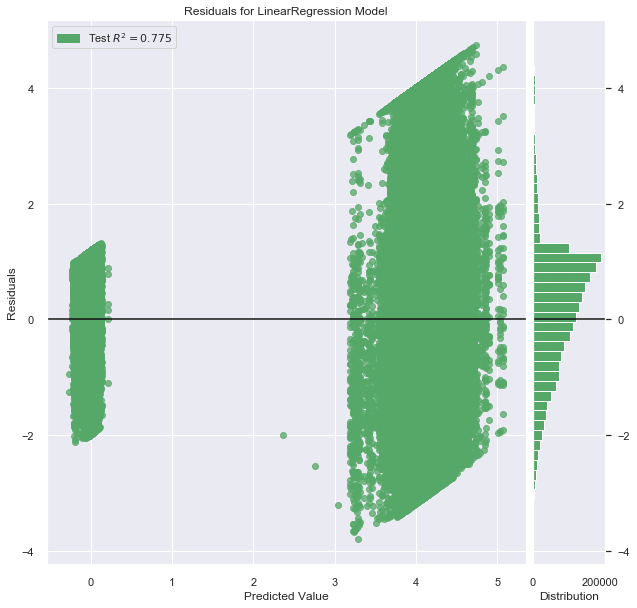

3418

In [177]:
# PLot Residual
plt.clf()
fig, ax = plt.subplots(1, 1, figsize = (10, 10))
visualizer = ResidualsPlot(model_wi, is_fitted = True, ax = ax)
visualizer.score(valid_wi, vmr)
visualizer.show()
del visualizer
gc.collect()

<Figure size 720x720 with 0 Axes>

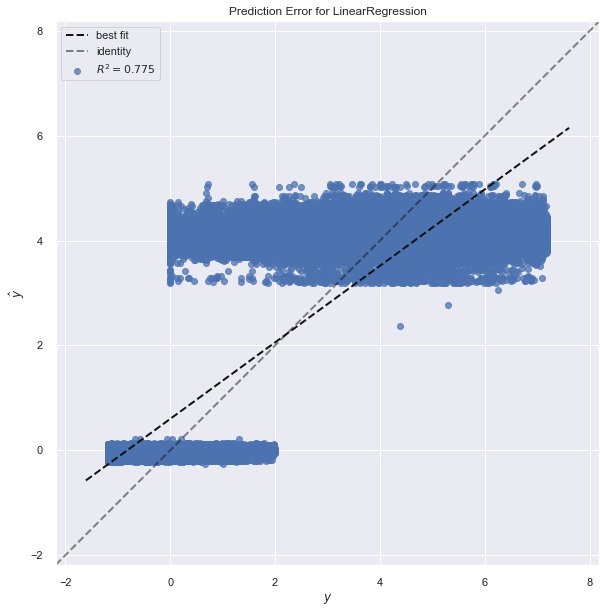

9069

In [178]:
# PLot Prediction Error
plt.clf()
fig, ax = plt.subplots(1, 1, figsize = (10, 10))
visualizer = PredictionError(model_wi, is_fitted = True, ax = ax)
visualizer.score(valid_wi, vmr)
visualizer.show()
del visualizer
gc.collect()

In [179]:
del model_wi, train_wi, valid_wi
gc.collect()

22

Since there's not much improvement in the model after including interaction terms, we have decided to not include interactions in the final model.

##### Meter reading using weather and building variables (without interaction)

In [180]:
train_wb = train[["meter_reading", "square_feet" ,"primary_use", "precip_depth_1_hr", "dew_temperature","air_temperature", "sea_level_pressure"]]
valid_wb = valid[["meter_reading", "square_feet" ,"primary_use", "precip_depth_1_hr", "dew_temperature","air_temperature", "sea_level_pressure"]]

train_wb_d = pd.get_dummies(train_wb)
valid_wb_d = pd.get_dummies(valid_wb)

In [181]:
model_wb = LinearRegression(fit_intercept=False)
model_wb.fit(train_wb_d.drop("meter_reading", axis = 1), train_wb_d["meter_reading"])  

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

In [182]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_wb_d.columns[1:], model_wb.coef_)})

Model Coefficients:
{'air_temperature': 0.014578524960002684,
 'dew_temperature': -0.0051527055042672465,
 'precip_depth_1_hr': 0.006030564479759689,
 'primary_use_Education': -0.2481930305496861,
 'primary_use_Entertainment/public assembly': -0.5071613997318123,
 'primary_use_Food sales and service': 0.029699807733898007,
 'primary_use_Healthcare': -0.16216977572256155,
 'primary_use_Lodging/residential': -0.23249854844073867,
 'primary_use_Manufacturing/industrial': -0.17428746367466932,
 'primary_use_Office': -0.2399515859617136,
 'primary_use_Other': -0.5738548264666746,
 'primary_use_Parking': -1.1033862360885462,
 'primary_use_Public services': -0.353141475471175,
 'primary_use_Religious worship': -1.113727248128771,
 'primary_use_Retail': -0.27742443868298383,
 'primary_use_Services': -0.7376386678735207,
 'primary_use_Technology/science': 0.04849108743934599,
 'primary_use_Utility': 0.09853364680570663,
 'primary_use_Warehouse/storage': -0.48479047314726426,
 'sea_level_pressur

<Figure size 720x720 with 0 Axes>

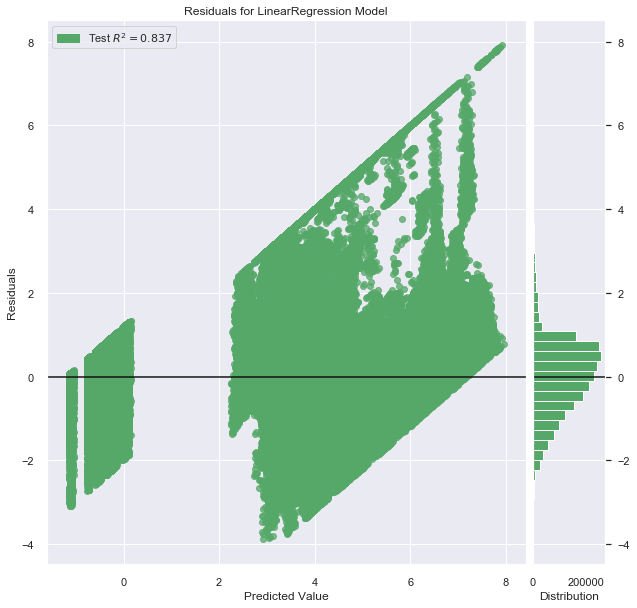

In [183]:
# PLot Residual
plot_residual(model_wb, valid_wb_d, ["Square Feet", "Building Use", "Precipitaion", "Dew Temperature", "Air Temperature", "Sea LEvel Pressure"])

<Figure size 720x720 with 0 Axes>

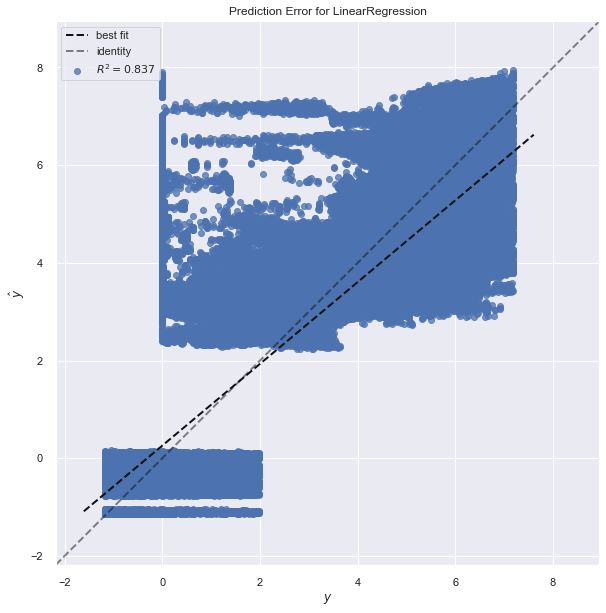

In [184]:
# PLot Prediction Error
plot_prederror(model_wb, valid_wb_d, ["Square Feet", "Building Use", "Precipitaion", "Dew Temperature", "Air Temperature", "Sea Level Pressure"])

In [185]:
del model_wb, train_wb_d, valid_wb_d
gc.collect()

2887

##### Meter reading using both square feet and primary reading (with interaction)

In [186]:
# train_grouped = train[["meter_reading", "square_feet", "primary_use"]].groupby("primary_use")
# valid_grouped = valid[["meter_reading", "square_feet", "primary_use"]].groupby("primary_use")

In [187]:
# for name, group in train_grouped:
#     fig, ax = plt.subplots(1,2, figsize = (16,7))
#     group.drop("primary_use", axis =1, inplace = True)
#     model = LinearRegression(fit_intercept = False)
#     model.fit(group.drop("meter_reading", axis = 1), group["meter_reading"])
#     visualizerR = ResidualsPlot(model, is_fitted = True, ax = ax[0])
#     visualizerPE = PredictionError(model, is_fitted = True, ax = ax[1])
#     test = valid_grouped.get_group(name)
#     test.drop("primary_use", axis =1, inplace = True)
#     visualizerR.score(test.drop("meter_reading", axis = 1), test["meter_reading"])
#     visualizerR.set_title("Residuals: "+name)
#     visualizerPE.score(test.drop("meter_reading", axis = 1), test["meter_reading"])
#     visualizerPE.set_title("Residuals: "+name)
# #     visualizerR.show()
# #     visualizerPE.show()
#     plt.show()
#     del visualizerR, visualizerPE, model, test
#     gc.collect()

##### Meter reading using time variables

In [188]:
train_t = train[["meter_reading", "day", "month", "is_holiday"]]
valid_t = valid[["meter_reading", "day", "month", "is_holiday"]]
train_t = train_t.dropna()
valid_t = valid_t.dropna()

train_t_d = pd.get_dummies(train_t)
valid_t_d = pd.get_dummies(valid_t)

In [189]:
model_t = LinearRegression(fit_intercept=False)
model_t.fit(train_t_d.drop("meter_reading", axis = 1), train_t_d["meter_reading"])  

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

In [190]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_t_d.columns[1:], model_t.coef_)})

Model Coefficients:
{'day': -0.22011763546476262,
 'is_holiday': -0.7276946540219426,
 'month': 0.3838242622664138}


<Figure size 720x720 with 0 Axes>

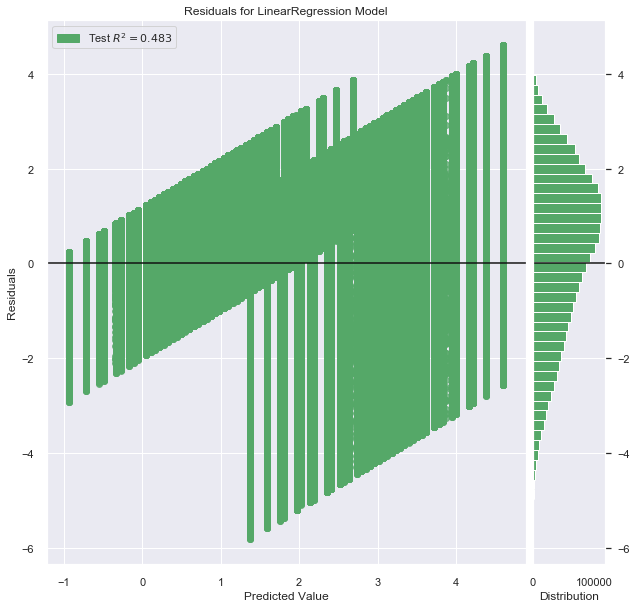

In [191]:
# PLot Residual
plot_residual(model_t, valid_t_d, ["Day", "Month", "Is Holiday"])

<Figure size 720x720 with 0 Axes>

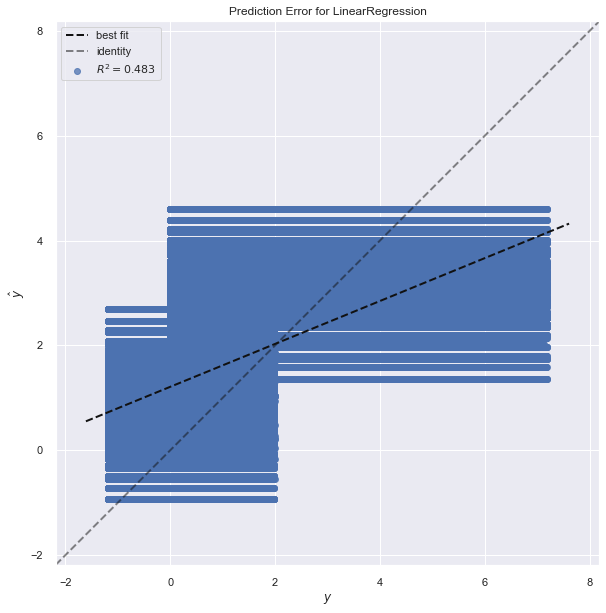

In [192]:
# PLot Prediction Error
plot_prederror(model_t, valid_t_d, ["Day", "Month", "Is Holiday"])

In [193]:
del model_t, train_t_d, valid_t_d
gc.collect()

2887

##### Meter reading using weather , building variables and time variables (without interaction)

In [194]:
train_all = train.dropna()
valid_all = valid.dropna()

train_all_d = pd.get_dummies(train_all)
valid_all_d = pd.get_dummies(valid_all)

In [195]:
model_all = LinearRegression(fit_intercept=False)
model_all.fit(train_all_d.drop("meter_reading", axis = 1), train_all_d["meter_reading"])  

LinearRegression(copy_X=True, fit_intercept=False, n_jobs=None, normalize=False)

In [196]:
pp = pprint.PrettyPrinter()
print('Model Coefficients:')
pp.pprint({col: coef for col, coef in zip(train_all_d.columns[1:], model_all.coef_)})

Model Coefficients:
{'air_temperature': 0.015863011706288992,
 'day': -0.013122959770257197,
 'dew_temperature': -0.004185389175845706,
 'is_holiday': -0.14323878531318138,
 'month': 0.02194230632276176,
 'precip_depth_1_hr': 0.006185952450921658,
 'primary_use_Education': -0.29705440442714376,
 'primary_use_Entertainment/public assembly': -0.5569442796484836,
 'primary_use_Food sales and service': -0.0189206771950899,
 'primary_use_Healthcare': -0.20913457452390638,
 'primary_use_Lodging/residential': -0.2826793435424989,
 'primary_use_Manufacturing/industrial': -0.21985653602992217,
 'primary_use_Office': -0.28814622489811553,
 'primary_use_Other': -0.6250055567623867,
 'primary_use_Parking': -1.1539247825228667,
 'primary_use_Public services': -0.40259373630150136,
 'primary_use_Religious worship': -1.1635548689628037,
 'primary_use_Retail': -0.32884437317399773,
 'primary_use_Services': -0.7866465527670913,
 'primary_use_Technology/science': 0.00360790202767638,
 'primary_use_Utili

<Figure size 720x720 with 0 Axes>

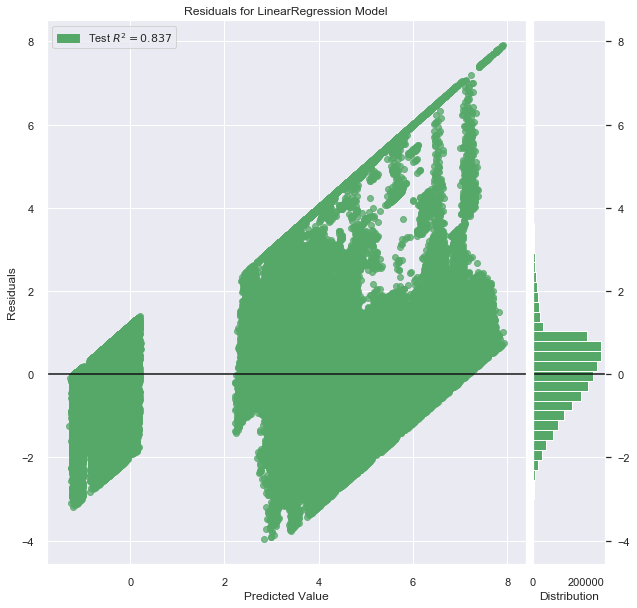

In [197]:
# PLot Residual
plot_residual(model_all, valid_all_d, ["Square Feet", "Building Use", "Precipitaion", "Dew Temperature", "Air Temperature", "Day","Month","Is Holiday"])

<Figure size 720x720 with 0 Axes>

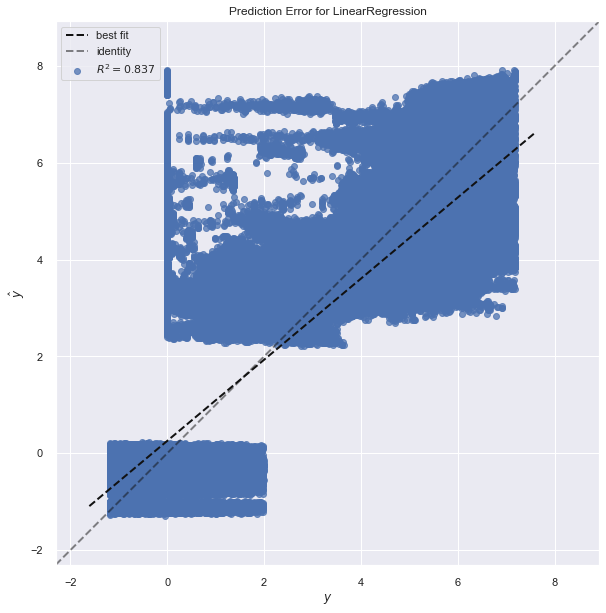

In [198]:
# PLot Prediction Error
plot_prederror(model_all, valid_all_d, ["Square Feet", "Building Use", "Precipitaion", "Dew Temperature", "Air Temperature", "Day", "Month","Is Holiday"])

In [199]:
del model_all, train_all_d, valid_all_d
gc.collect()

2887